# Progetto di Introduzione ad analisi dati


# Analisi da scegliere

<a id="1"></a>
## 1. Introduzione


Soggetto di questo progetto è lo studio e l'analisi della personalità del cliente, cercando un'analisi dettagliata dei clienti ideali di un'azienda. Questa analisi aiuta a comprendere meglio i bisogni, le preferenze e i comportamenti dei clienti, permettendo all'azienda di modificare i propri prodotti in base alle esigenze specifiche dei diversi tipi di clienti e di indirizzare la propria attività di marketing verso i segmenti di clientela più propensi ad acquistare i prodotti offerti.

Si vogliono inoltre creare dei regressori e classificatori per predire delle features in base ai dati forniti dai vari dataset, in particolare si effettuerà una analisi di regressione e dipendenza tra le varie feature per predirre i redditi (Income) dei clienti. Successivamente si procederà con la segmentazione dei clienti in cluster per definire una scala dei i clienti più ricchi e propensi a spendere. La clusterizzazione viene utilizzata per creare, dunque, delle etichette che verranno aggiunte come attributo per poi poter effettuare la classificazione di queste etichette. 

Verranno utilizzate tecniche di riduzione delle dimensionalità: PCA e LDA, una di tipo non supervisionato, utilizzando la varianza degli attributi, in maniera tale da prendere le variabili con varianza più alta, e una di tipo supervisionato, in maniera tale da tenere in considerazione l'appartenenza alla classe.



* Descrizione del dataset
* Dataset cleaning and pre-processing
* Trovare le associazioni nel dataset
* Indici vari, momenti, riduzione della dimensionalità dei dati tramite LDA, PCA. 
* Predirre i redditi effettuando una analisi di regressione e dipendenza tra le varie feature.
* Riduzione della dimensionalità dei dati tramite PCA.
* Metodo creazione etichette per classificazione tramite clustering e poi classificazione di quest'ultime.
* Riduzione della dimensionalità dei dati tramite LDA. 
* Classificazione tramite Logistic Regression, Bayes, LDA, SVM, alberi decisionali, foreste di alberi, K-NN, rete neurale.
* Controllo di validità e consistenza dei modelli e dei dati.



Attributi

Persona

* ID: Identificatore univoco del cliente
* Anno: anno di nascita del cliente
* Istruzione: livello di istruzione del cliente
* Marital_Status: stato civile del cliente
* Reddito: reddito annuo della famiglia del cliente
* Kidhome: numero di bambini nella famiglia del cliente
* Teenhome: Numero di adolescenti nella famiglia del cliente
* Dt_Customer: Data di iscrizione del cliente all'azienda
* Recency: Numero di giorni dall'ultimo acquisto del cliente
* Reclamo: 1 se il cliente si è lamentato negli ultimi 2 anni, 0 altrimenti

Prodotti

* MntWines: Quantità spesa in vino negli ultimi 2 anni
* MntFruits: Importo speso per la frutta negli ultimi 2 anni
* MntMeatProdotti: Quantità spesa per la carne negli ultimi 2 anni
* MntFishProdotti: Quantità spesa per il pesce negli ultimi 2 anni
* MntSweetProdotti: Quantità spesa per i dolci negli ultimi 2 anni
* MntGoldProds: Importo speso in oro negli ultimi 2 anni

Promozione

* NumDealsPurchases: Numero di acquisti effettuati con uno sconto
* AcceptedCmp1: 1 se il cliente ha accettato l'offerta nella prima campagna, 0 altrimenti
* AcceptedCmp2: 1 se il cliente ha accettato l'offerta nella seconda campagna, 0 altrimenti
* AcceptedCmp3: 1 se il cliente ha accettato l'offerta nella terza campagna, 0 altrimenti
* AcceptedCmp4: 1 se il cliente ha accettato l'offerta nella quarta campagna, 0 altrimenti
* AcceptedCmp5: 1 se il cliente ha accettato l'offerta nella quinta campagna, 0 altrimenti
* Risposta: 1 se il cliente ha accettato l'offerta nell'ultima campagna, 0 altrimenti

Luogo

* NumWebPurchases: Numero di acquisti effettuati tramite il sito web della società
* NumCatalogPurchases: Numero di acquisti effettuati utilizzando un catalogo
* NumStorePurchases: Numero di acquisti effettuati direttamente nei negozi
* NumWebVisitsMonth: numero di visite al sito web dell'azienda nell'ultimo mese

Link al dataset kaggle: https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis

<a id="2"></a>
## 2. Imports



In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np
import datetime
from datetime import date
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler, normalize
from sklearn import metrics
from sklearn.mixture import GaussianMixture
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from sklearn.cluster import KMeans, AgglomerativeClustering


from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer

import warnings
warnings.filterwarnings('ignore')

/Users/giovanni/opt/anaconda3/envs/jupyter/lib/python3.9/site-packages/yellowbrick/style/colors.py:35: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  mpl_ge_150 = LooseVersion(mpl.__version__) >= "1.5.0"
/Users/giovanni/opt/anaconda3/envs/jupyter/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/Users/giovanni/opt/anaconda3/envs/jupyter/lib/python3.9/site-packages/yellowbrick/style/rcmod.py:31: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  mpl_ge_150 = LooseVersion(mpl.__version__) >= "1.5.0"
/Users/giovanni/opt/anaconda3/envs/jupyter/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


<a id="3"></a>
# <div style="font-size:100%; font-family:Courier New; color: #000; line-height: 1;"><b>3. Data exploration, Cleaning and Pre-processing</b></div>

In [2]:
dataset = pd.read_csv("marketing_campaign.csv", sep="\t")


In [3]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [4]:
dataset.isnull().values.any()

True

In base alle operazioni effettuate sopra, si evince che vi sono dei valori di tipo "object" che saranno gestiti successivamente. Inoltre, si nota che nell'attributo "Income" vi sono valori nulli o NAN, dovuti al fatto che l'azienda non ha informazioni complete su tutti i clienti. Pertanto, si procederà eliminando le righe che contengono valori nulli. In alternativa, si può sostituire i valori nulli con la media dei valori presenti nell'attributo "Income".

<a id="3_1"></a>
### 3.1 Numerosità del dataset


In [5]:
dataset.count()

ID                     2240
Year_Birth             2240
Education              2240
Marital_Status         2240
Income                 2216
Kidhome                2240
Teenhome               2240
Dt_Customer            2240
Recency                2240
MntWines               2240
MntFruits              2240
MntMeatProducts        2240
MntFishProducts        2240
MntSweetProducts       2240
MntGoldProds           2240
NumDealsPurchases      2240
NumWebPurchases        2240
NumCatalogPurchases    2240
NumStorePurchases      2240
NumWebVisitsMonth      2240
AcceptedCmp3           2240
AcceptedCmp4           2240
AcceptedCmp5           2240
AcceptedCmp1           2240
AcceptedCmp2           2240
Complain               2240
Z_CostContact          2240
Z_Revenue              2240
Response               2240
dtype: int64

In [6]:
dataset.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


<a id="4"></a>
### <div style="font-size:100%; font-family:Courier New; color: #000; line-height: 1;"><b>3.2 Data Pre-processing</b></div>

In questa sezione, verranno preparati i dati per eseguire le prossime operazioni.

**Per la pre-elaborazione dei dati vengono applicati i seguenti passaggi:**

* Vengono gestiti i dati mancanti
* Vengono creati nuove features utili per lo sviluppo delle operazioni successive

In [7]:
dataset = dataset.dropna() 
dataset.count()

ID                     2216
Year_Birth             2216
Education              2216
Marital_Status         2216
Income                 2216
Kidhome                2216
Teenhome               2216
Dt_Customer            2216
Recency                2216
MntWines               2216
MntFruits              2216
MntMeatProducts        2216
MntFishProducts        2216
MntSweetProducts       2216
MntGoldProds           2216
NumDealsPurchases      2216
NumWebPurchases        2216
NumCatalogPurchases    2216
NumStorePurchases      2216
NumWebVisitsMonth      2216
AcceptedCmp3           2216
AcceptedCmp4           2216
AcceptedCmp5           2216
AcceptedCmp1           2216
AcceptedCmp2           2216
Complain               2216
Z_CostContact          2216
Z_Revenue              2216
Response               2216
dtype: int64

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2216 non-null   int64  
 1   Year_Birth           2216 non-null   int64  
 2   Education            2216 non-null   object 
 3   Marital_Status       2216 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2216 non-null   int64  
 6   Teenhome             2216 non-null   int64  
 7   Dt_Customer          2216 non-null   object 
 8   Recency              2216 non-null   int64  
 9   MntWines             2216 non-null   int64  
 10  MntFruits            2216 non-null   int64  
 11  MntMeatProducts      2216 non-null   int64  
 12  MntFishProducts      2216 non-null   int64  
 13  MntSweetProducts     2216 non-null   int64  
 14  MntGoldProds         2216 non-null   int64  
 15  NumDealsPurchases    2216 non-null   i



**Dall'output sopra, si nota che:**

* la variabile "Dt_Customer" indica la data in cui un cliente è stato inserito nel database. Essa però non viene analizzata come DateTime, quindi verrà gestita e sostituita dalla nuova variabile "Customer_for" che indicherà il numero di giorni d'iscrizione. Come data di riferimento viene preso la data dell'ultimo utente inserito ( il più recente).
* Vi sono anche altre caratteristiche categoriche nel nostro dataset di tipo object. Quindi verranno codificate in forme numeriche.


In [9]:
dataset["Dt_Customer"] = pd.to_datetime(dataset["Dt_Customer"])
dates = []
for i in dataset["Dt_Customer"]:
    i = i.date()
    dates.append(i)  
    
#Creazione della feature "Customer_For"
days = []
data1 = max(dates)
for i in dates:
    diff = data1 - i
    days.append(diff)
dataset["Customer_For"] = days
dataset["Customer_For"] = pd.to_numeric(dataset["Customer_For"], errors="coerce")


Di seguito, verranno inserite nuove features che rappresenteranno meglio il dataset. Verranno aggiunte nello specifico:

* L'età di un cliente;
* Le spese che indicano l'importo totale speso dal cliente in varie categorie. 
* L'attributo "Living_With" da "Marital_Status" per estrarre la situazione di vita delle coppie. 
* Unire il numero di figli presenti in famiglia per indicare i figli totali. 
* L'attributo "Is_Parent" verrà utilizzato per indicare se il cliente in questione è genitore o meno. 
* Infine la categoria "Istruzione" verrà semplificata in Undergraduate e Postgraduate. 

* Verrano pure eliminate le features che non servono per questo progetto

In [10]:
#Età
dataset["Age"] = 2022-dataset["Year_Birth"]

#Spesa totale effettuata
dataset["AmountSpent"] = dataset["MntWines"]+ dataset["MntFruits"]+ dataset["MntMeatProducts"]+ dataset["MntFishProducts"]+ dataset["MntSweetProducts"]+ dataset["MntGoldProds"]

#Situazione familiare
dataset["Living_With"]=dataset["Marital_Status"].replace({"Married":"Partner", "Together":"Partner", "Absurd":"Alone", "Widow":"Alone", "YOLO":"Alone", "Divorced":"Alone", "Single":"Alone",})

#Numero totale di figli
dataset["Children"]=dataset["Kidhome"]+dataset["Teenhome"]

#Grandezza della famiglia
dataset["Family_Size"] = dataset["Living_With"].replace({"Alone": 1, "Partner":2})+ dataset["Children"]

#Stato genitorialità
dataset["Is_Parent"] = np.where(dataset.Children> 0, 1, 0)

#Semplificazione dell'istruzione
dataset["Education"]=dataset["Education"].replace({"Basic":"UG","2n Cycle":"PG", "Graduation":"UG", "Master":"PG", "PhD":"PG"})


dataset=dataset.rename(columns={"MntWines": "Wines","MntFruits":"Fruits","MntMeatProducts":"Meat","MntFishProducts":"Fish","MntSweetProducts":"Sweets","MntGoldProds":"Gold"})

#Offerte totali accettate
dataset['TotalAcceptedCmp'] = dataset['AcceptedCmp1'] + dataset['AcceptedCmp2'] + dataset['AcceptedCmp3'] + dataset['AcceptedCmp4'] + dataset['AcceptedCmp5'] + dataset['Response']

#Numero di acquisti
dataset['NumTotalPurchases'] = dataset['NumWebPurchases'] + dataset['NumCatalogPurchases'] + dataset['NumStorePurchases'] + dataset['NumDealsPurchases']


In [11]:
dataset.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,Wines,...,Response,Customer_For,Age,AmountSpent,Living_With,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases
0,5524,1957,UG,Single,58138.0,0,0,2012-04-09,58,635,...,1,83894400000000000,65,1617,Alone,0,1,0,1,25
1,2174,1954,UG,Single,46344.0,1,1,2014-08-03,38,11,...,0,10800000000000000,68,27,Alone,2,3,1,0,6
2,4141,1965,UG,Together,71613.0,0,0,2013-08-21,26,426,...,0,40780800000000000,57,776,Partner,0,2,0,0,21
3,6182,1984,UG,Together,26646.0,1,0,2014-10-02,26,11,...,0,5616000000000000,38,53,Partner,1,3,1,0,8
4,5324,1981,PG,Married,58293.0,1,0,2014-01-19,94,173,...,0,27734400000000000,41,422,Partner,1,3,1,0,19


### 3.3. Donut Charts

In [12]:
education_count = dataset.groupby(['Education']).size().reset_index().rename(columns={0: 'count'})
marital_count = dataset.groupby(['Living_With']).size().reset_index().rename(columns={0: 'count'})
children_count = dataset.groupby(['Children']).size().reset_index().rename(columns={0: 'count'})
campaigns_count = dataset.groupby(['TotalAcceptedCmp']).size().reset_index().rename(columns={0: 'count'})

fig = make_subplots(rows=2, cols=2,
                    specs=[[{'type':'domain'}, {'type':'domain'}],
                           [{'type':'domain'}, {'type':'domain'}]
                          ])

## Education Donut Chart
fig.add_trace(
    go.Pie(
        labels=education_count['Education'],
        values=education_count['count'],
        hole=.6,
        title='Education',
        titlefont={'color':None, 'size': 24},
        ),
    row=1,col=1
    )

## Marital_Status Donut Chart
fig.add_trace(
    go.Pie(
        labels=marital_count['Living_With'],
        values=marital_count['count'],
        hole=.6,
        title='Marital Status',
        titlefont={'color':None, 'size': 24},       
        ),
    row=1,col=2
    )

## ChildrenHome Donut Chart
fig.add_trace(
    go.Pie(
        labels=children_count['Children'],
        values=children_count['count'],
        hole=.6,
        title='Children Home',
        titlefont={'color':None, 'size': 24},
        ),
    row=2,col=1
    )


## Total Accepted Campaigns Donut Chart
fig.add_trace(
    go.Pie(
        labels=campaigns_count['TotalAcceptedCmp'],
        values=campaigns_count['count'],
        hole=.6,
        title='Accepted Campaigns',
        titlefont={'color':None, 'size': 24},
        ),
    row=2,col=2
    )

fig.update_traces(
    hoverinfo='label+value',
    textinfo='label+percent',
    textfont_size=12,
    marker=dict(
        colors=['#FF1654', '#20A4F3', '#56E39F', '#F9C846', '#4C5760'],
        line=dict(color='#EEEEEE',
                  width=2)
        )
    )


fig.layout.update(title="Donut Charts <b>",
                  titlefont={'color':None, 'size': 28, 'family': 'Courier New'},
                  showlegend=False, 
                  height=800, 
                  width=1000,
                  title_x=0.5
                  )
fig.show()

In [13]:
## Grouping Datasets
education_marital_df = dataset.groupby(['Education', 'Living_With']).size().reset_index().rename(columns={0: 'count'})
education_children_df = dataset.groupby(['Education', 'Children']).size().reset_index().rename(columns={0: 'count'})

## Creating Sunburst Figures
sb1 = px.sunburst(education_marital_df, values='count', path=['Education', 'Living_With'])
sb2 = px.sunburst(education_children_df, values='count', path=['Education', 'Children'])

## Subplots
fig = make_subplots(rows=2, cols=1, specs=[
    [{"type": "sunburst"},],
    [{"type": "sunburst"}]
], subplot_titles=("Education and Marital Status", "Education and Num of Children"))

## Plotting Figures
fig.add_trace(sb1.data[0], row=1, col=1)
fig.add_trace(sb2.data[0], row=2, col=1)

fig.update_traces(textinfo="label+percent parent")

# Update title and height
fig.update_layout(title_text="Sunbursts", title_x=0.5, height=900, showlegend=False,
        font=dict(
            family="Rubik",
            size=14)
)

fig.show()

In [14]:
print("Total categories in the feature Marital_Status:\n", dataset["Marital_Status"].value_counts(), "\n")
print("Total categories in the feature Education:\n", dataset["Education"].value_counts())

#dataset["Marital_Status"].hist()
#dataset["Education"].hist()

Total categories in the feature Marital_Status:
 Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64 

Total categories in the feature Education:
 UG    1170
PG    1046
Name: Education, dtype: int64


## 3.4 Categorical attributes

Vengono eliminati le features che non sono utili per lo sviluppo di questo progetto (perchè ridontanti o inutili)

In [15]:
to_drop = ["Marital_Status", "Dt_Customer", "Z_CostContact", "Z_Revenue", "Year_Birth", "ID"]
dataset = dataset.drop(to_drop, axis=1)


In [16]:
dataset.head()

,Education,Income,Kidhome,Teenhome,Recency,Wines,Fruits,Meat,Fish,Sweets,...,Response,Customer_For,Age,AmountSpent,Living_With,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases
0,UG,58138.0,0,0,58,635,88,546,172,88,...,1,83894400000000000,65,1617,Alone,0,1,0,1,25
1,UG,46344.0,1,1,38,11,1,6,2,1,...,0,10800000000000000,68,27,Alone,2,3,1,0,6
2,UG,71613.0,0,0,26,426,49,127,111,21,...,0,40780800000000000,57,776,Partner,0,2,0,0,21
3,UG,26646.0,1,0,26,11,4,20,10,3,...,0,5616000000000000,38,53,Partner,1,3,1,0,8
4,PG,58293.0,1,0,94,173,43,118,46,27,...,0,27734400000000000,41,422,Partner,1,3,1,0,19


# 4. Analisi statistica

### 4.1 Istogrammi

Di seguito vediamoo gli istogrammi iniziali tramite EDA: (Exploratory Data Analysis) è il processo di analisi dei dati finalizzato a comprendere le caratteristiche dei dati e a individuare pattern e relazioni all'interno di essi. In genere, l'EDA viene utilizzata come prima fase di un progetto di data science e può aiutare a identificare le opportunità di analisi e a progettare un piano per il resto del progetto.


  0%|                                                  | 0/1768 [00:00<?, ?it/s]


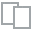
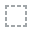
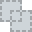
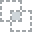
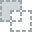
...
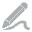
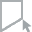
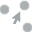
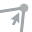
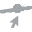

In [17]:
### 4.1.1 EDA EXECUTION

from dataprep.eda import plot, plot_correlation, create_report, plot_missing
plot(dataset)

Di seguito vengono visti gli istogrammi dei vari attributi, per dare una prima occhiata alle forme delle distribuzioni con la ricerca di possibili similarità tra le distribuzioni. Si presterà maggiore attenzione all'attributo "Income" che si cercherà di reggredire successivamente, dopo un accurata fase di studio della densità.

Per stabilire il numero di classi per bin, verrà calcolata la radice quadrata del numero di record o, in alternativa, si può applicare la regola di Stokes basandosi sul logaritmo.

Gli intervalli saranno uniformi e avranno un'ampiezza specificata, che verrà ottenuta utilizzando le funzioni di matplotlib o pandas:\\[h={\frac{max-min}{nbins}}\\]

In [18]:
fig=make_subplots(rows=3,cols=2,subplot_titles=('<i>Age', '<i>Income', '<i>Amount Spent', '<i>Customer for', '<i>NumTotalPurchases'))
fig.add_trace(go.Histogram(x=dataset['Age'],name='Age'),row=1,col=1)
fig.add_trace(go.Histogram(x=dataset['Income'],name='Income'),row=1,col=2)
fig.add_trace(go.Histogram(x=dataset['AmountSpent'],name='AmountSpent'),row=2,col=1)
fig.add_trace(go.Histogram(x=dataset['Customer_For'],name='Customer_For'),row=2,col=2)
fig.add_trace(go.Histogram(x=dataset['NumTotalPurchases'],name='NumTotalPurchases'),row=3,col=1)


fig.update_layout(height=600, width=1000, title_text='<b>Histograms', font_size=20)
fig.update_layout(title_x=0.5, font_family='Courier New', showlegend=False)

48


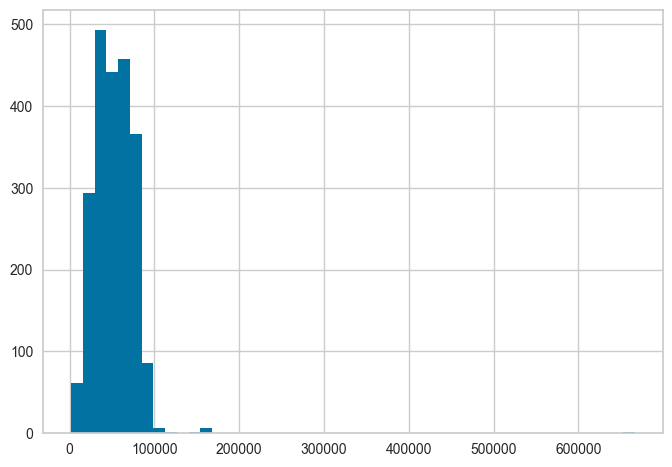

In [19]:
import math
n_bins = math.ceil(math.sqrt(dataset.shape[0]+1))
plt.hist(dataset["Income"],bins=n_bins)
IncomeBinWidth = (dataset["Income"].max()-dataset["Income"].min())/n_bins
print(n_bins)

Si vede l'istogrammi normalizzato dell'attributo Income:

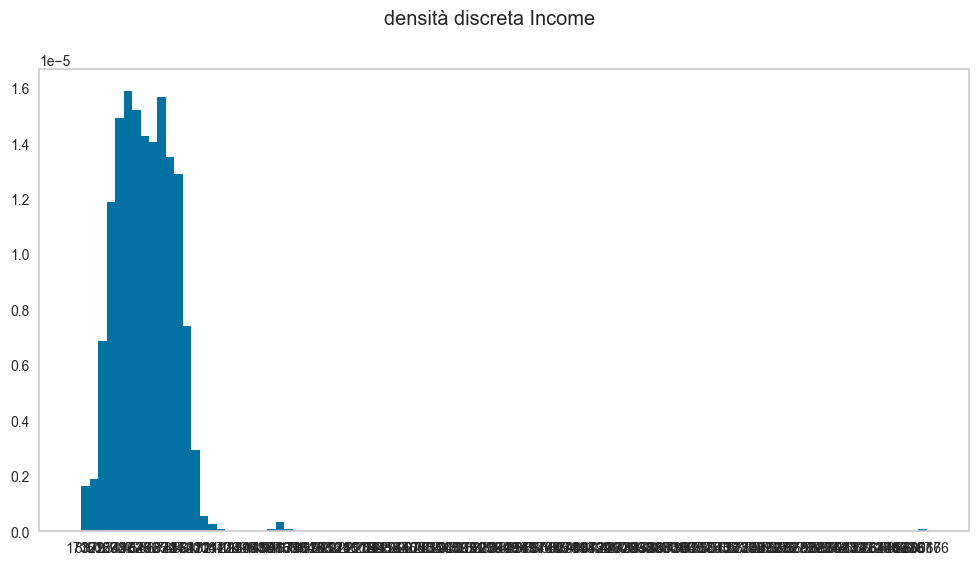

In [20]:
fig = plt.figure(figsize=(12,6))
binsIncome = list(np.arange(dataset["Income"].min(),dataset["Income"].max(),IncomeBinWidth))
valori,bordi,_=plt.hist(dataset["Income"], bins=100, density=True)
plt.xticks(bordi)
plt.grid()
fig.suptitle("densità discreta Income")
plt.show()

### 4.2 Indici vari 

#### 4.2.1 Indicatori centrali

Di seguito si vedono indicatori di centralità 


In [21]:
IncomeMean = dataset["Income"].mean()
AgeMean = dataset["Age"].mean()
AmountSpentMean = dataset["AmountSpent"].mean()
CustomerforMean = dataset["Customer_For"].mean()
print("Income medio: "+str(IncomeMean))
print("Età media: "+str(AgeMean))
print("Spesa media: "+str(AmountSpentMean))
print("Customer_for media: "+str(CustomerforMean))

Income medio: 52247.25135379061
Età media: 53.17960288808664
Spesa media: 607.0753610108303
Customer_for media: 4.423734584837545e+16


In [22]:
IncomeMedian = dataset["Income"].median()
AgeMedian = dataset["Age"].median()
AmountSpentMedian = dataset["AmountSpent"].median()
CustomerforMedian = dataset["Customer_For"].median()
print("Mediana Income: "+str(IncomeMedian))
print("Mediana Età: "+str(AgeMedian))
print("Mediana Spesa: "+str(AmountSpentMedian))
print("Mediana Customer_for: "+str(CustomerforMedian))

Mediana Income: 51381.5
Mediana Età: 52.0
Mediana Spesa: 396.5
Mediana Customer_for: 4.43232e+16


#### 4.2.2 Indicatori di dispersione

In [23]:
IncomeVar = dataset["Income"].var()
AgeVar = dataset["Age"].var()
AmountSpentVar = dataset["AmountSpent"].var()
CustomerforVar = dataset["Customer_For"].var()
print("Var Income: "+str(IncomeVar))
print("Var Età: "+str(AgeVar))
print("Var Spesa: "+str(AmountSpentVar))
print("Var Customer_for: "+str(CustomerforVar))

Var Income: 633683788.5756189
Var Età: 143.6535070205605
Var Spesa: 363488.9843858741
Var Customer_for: 4.034202626012017e+32


Un modo per avere tutte le informazioni descritte precedentemente è utilizzare la funzione describe.

In [24]:
dataset.describe()

,Income,Kidhome,Teenhome,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,...,Complain,Response,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases
count,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,...,2216.000000,2216.000000,2.216000e+03,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000
mean,52247.251354,0.441787,0.505415,49.012635,305.091606,26.356047,166.995939,37.637635,27.028881,43.965253,...,0.009477,0.150271,4.423735e+16,53.179603,607.075361,0.947202,2.592509,0.714350,0.448556,14.880866
std,25173.076661,0.536896,0.544181,28.948352,337.327920,39.793917,224.283273,54.752082,41.072046,51.815414,...,0.096907,0.357417,2.008532e+16,11.985554,602.900476,0.749062,0.905722,0.451825,0.892440,7.670957
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000e+00,26.000000,5.000000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,35303.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,1.000000,9.000000,...,0.000000,0.000000,2.937600e+16,45.000000,69.000000,0.000000,2.000000,0.000000,0.000000,8.000000
50%,51381.500000,0.000000,0.000000,49.000000,174.500000,8.000000,68.000000,12.000000,8.000000,24.500000,...,0.000000,0.000000,4.432320e+16,52.000000,396.500000,1.000000,3.000000,1.000000,0.000000,15.000000
75%,68522.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.250000,50.000000,33.000000,56.000000,...,0.000000,0.000000,5.927040e+16,63.000000,1048.000000,1.000000,3.000000,1.000000,1.000000,21.000000
max,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,...,1.000000,1.000000,9.184320e+16,129.000000,2525.000000,3.000000,5.000000,1.000000,5.000000,44.000000


Dalle statistiche sopra si vedono alcune discrepanze nel reddito medio e età 

Alcuni dati sono vecchi e mostrano un età di 128 anni per alcune persone.

Di seguito, si procederà a trovare gli outlier, se presenti.

Plotting of Features: A Data Subset


<Figure size 800x550 with 0 Axes>

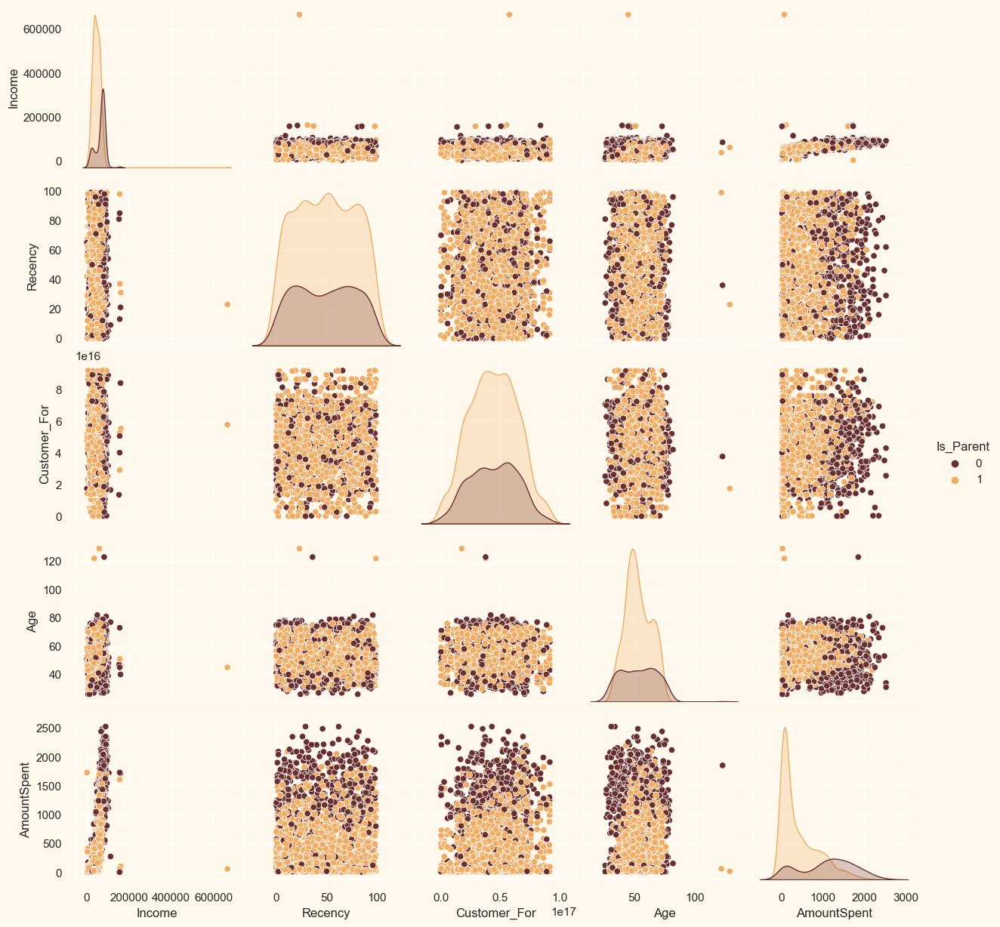

In [25]:
#To plot some selected features 
#Setting up colors prefrences
sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#FFF9ED"})
pallet = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"]
cmap = colors.ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"])
#Plotting following features
To_Plot = [ "Income", "Recency", "Customer_For", "Age", "AmountSpent", "Is_Parent"]
print("Plotting of Features: A Data Subset")
plt.figure()
sns.pairplot(dataset[To_Plot], hue= "Is_Parent",palette= (["#682F2F","#F3AB60"]))
#Taking hue 
plt.show()

Dal grafico precedente si evidenziano alcuni possibili Outlier. Si procederà con un ulteriore verifica tramite Box-Plot:

In [26]:
fig=make_subplots(rows=2,cols=2,subplot_titles=('<i>Age', '<i>Income', '<i>Amount Spent', '<i>Customer For'))
fig.add_trace(go.Box(x=dataset['Age'],name='Age'),row=1,col=1)
fig.add_trace(go.Box(x=dataset['Income'],name='Income'),row=1,col=2)
fig.add_trace(go.Box(x=dataset['AmountSpent'],name='AmountSpent'),row=2,col=1)
fig.add_trace(go.Box(x=dataset['Customer_For'],name='Customer_For'),row=2,col=2)

fig.update_yaxes(visible=False, showticklabels=False)
fig.update_layout(height=600, width=1000, title_text='<b>Box Plots to Check Outliers', font_size=20)
fig.update_layout(title_x=0.5, font_family='Courier New', showlegend=False)

Dal grafico precedente si evince che vi sono dei punti outlier negli attributi Age ed Income. Quelli su AmountSpent vengono lasciati perché non vi può essere un limite sul reddito, come invece nel caso dell'età.

In [27]:
#Dropping the outliers.
dataset = dataset[(dataset["Age"]<90)]
dataset = dataset[(dataset["Income"]<150000)]

In [28]:
fig=make_subplots(rows=2,cols=2,subplot_titles=('<i>Age', '<i>Income', '<i>Amount Spent', '<i>Customer For'))
fig.add_trace(go.Box(x=dataset['Age'],name='Age'),row=1,col=1)
fig.add_trace(go.Box(x=dataset['Income'],name='Income'),row=1,col=2)
fig.add_trace(go.Box(x=dataset['AmountSpent'],name='AmountSpent'),row=2,col=1)
fig.add_trace(go.Box(x=dataset['Customer_For'],name='Customer_For'),row=2,col=2)

fig.update_yaxes(visible=False, showticklabels=False)
fig.update_layout(height=600, width=1000, title_text='<b>Box Plots to Check Outliers', font_size=20)
fig.update_layout(title_x=0.5, font_family='Courier New', showlegend=False)

#### 4.2.4 Indici di forma


In [29]:
dataset.skew()

Income                  0.013164
Kidhome                 0.635495
Teenhome                0.404623
Recency                -0.001874
Wines                   1.166917
Fruits                  2.099281
Meat                    1.818916
Fish                    1.912028
Sweets                  2.098355
Gold                    1.834468
NumDealsPurchases       2.312369
NumWebPurchases         1.201376
NumCatalogPurchases     1.368122
NumStorePurchases       0.706960
NumWebVisitsMonth       0.229994
AcceptedCmp3            3.259123
AcceptedCmp4            3.246508
AcceptedCmp5            3.284676
AcceptedCmp1            3.551642
AcceptedCmp2            8.402967
Complain               10.363651
Response                1.950559
Customer_For            0.004530
Age                     0.089941
AmountSpent             0.859552
Children                0.407625
Family_Size             0.084408
Is_Parent              -0.954259
TotalAcceptedCmp        2.433255
NumTotalPurchases       0.229946
dtype: flo

Come si può vedere chiaramente dal valore risultante, l'asimmetria del reddito familiare è quasi nulla, quindi questo fa pensare che la distribuzione potrebbe avere un andamento a campana tipico della gaussiana.
Le altre feature hanno leggere simmetrie a destra (per valori maggiori di 0) o a sinistra (per valori minori di 0).

In [30]:
dataset.kurtosis()

Income                  -0.847564
Kidhome                 -0.789442
Teenhome                -0.989633
Recency                 -1.198443
Wines                    0.574909
Fruits                   4.050778
Meat                     3.248138
Fish                     3.056338
Sweets                   4.079829
Gold                     3.143759
NumDealsPurchases        8.186671
NumWebPurchases          4.101823
NumCatalogPurchases      3.210414
NumStorePurchases       -0.635247
NumWebVisitsMonth        1.904398
AcceptedCmp3             8.629707
AcceptedCmp4             8.547565
AcceptedCmp5             8.797075
AcceptedCmp1            10.623796
AcceptedCmp2            68.672133
Complain               105.500953
Response                 1.806319
Customer_For            -0.647768
Age                     -0.797036
AmountSpent             -0.335066
Children                -0.259602
Family_Size             -0.352987
Is_Parent               -1.090380
TotalAcceptedCmp         6.291950
NumTotalPurcha

La kurtosi indica una distribuzione leggermente schiacciata (platicurtica). Se ci fosse stata una distribuzione perfettamente normale il valore di curtosi sarebbe stato di circa 0.

## 4.3 Analisi densità

In questa sezione verranno viste delle tecniche di stima della densità sull'attributo Income ed età.

Si parte prima di tutto con dei metodi grafici (istogrammi), successivamente viene visto il QQ-plot dei dati in modo da testare l'andamento normale dei dati.

Verranno inoltre utilizzati dei metodi statistici per i test di bontà di adattamento (goodness of fit) per la ricerca delle migliori densità stimate per il singolo dataset.

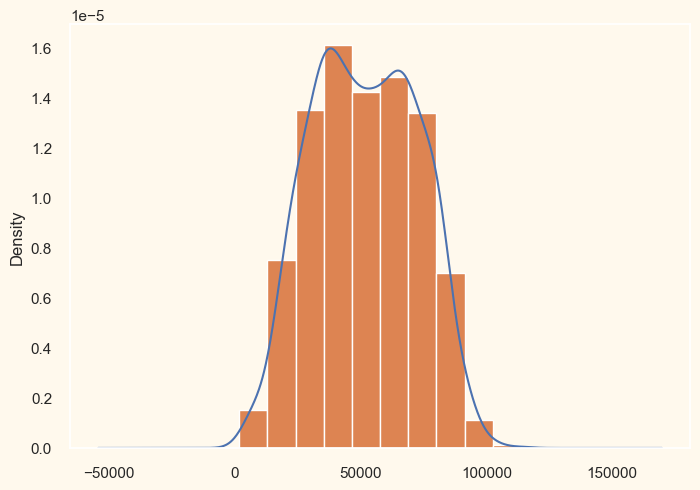

In [31]:
plots = dataset["Income"].plot.density()
plt.hist(dataset["Income"], density=True)
plt.grid()
plt.show()

Let's have a look on the distribution of customer's Income :


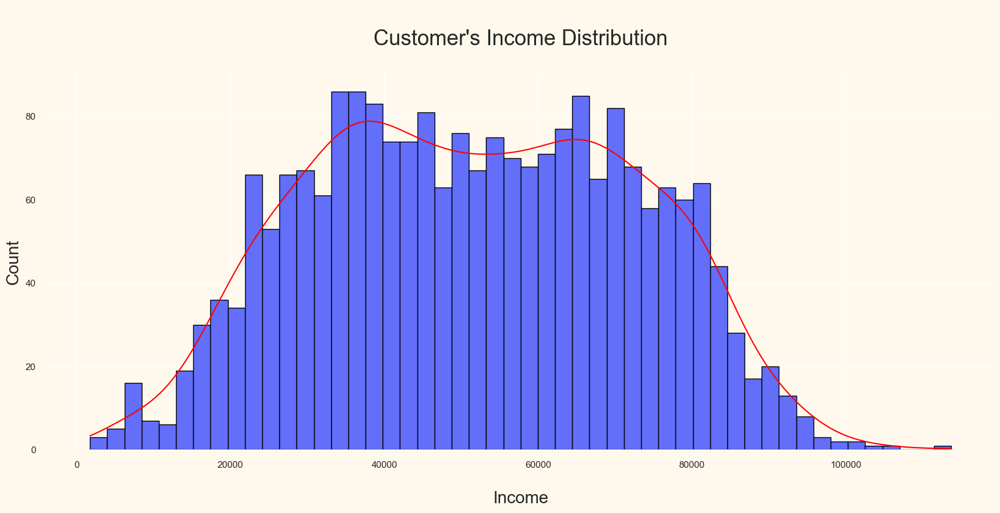

In [32]:
print(f"Let's have a look on the distribution of customer's Income :")
plt.subplots(figsize=(20, 8))
p = sns.histplot(dataset["Income"],color="#636ef9",kde=True,bins=50,alpha=1,fill=True,edgecolor="black")
p.axes.lines[0].set_color("red")
p.axes.set_title("\nCustomer's Income Distribution\n",fontsize=25)
plt.ylabel("Count",fontsize=20)
plt.xlabel("\nIncome",fontsize=20)
sns.despine(left=True, bottom=True)

plt.show()

#import math
#n_bins = math.ceil(math.sqrt(dataset.shape[0]+1))
#plt.hist(scaled_ds["Income"],bins=n_bins)
#IncomeBinWidth = (scaled_ds["Income"].max()-scaled_ds["Income"].min())/n_bins
#print(n_bins)

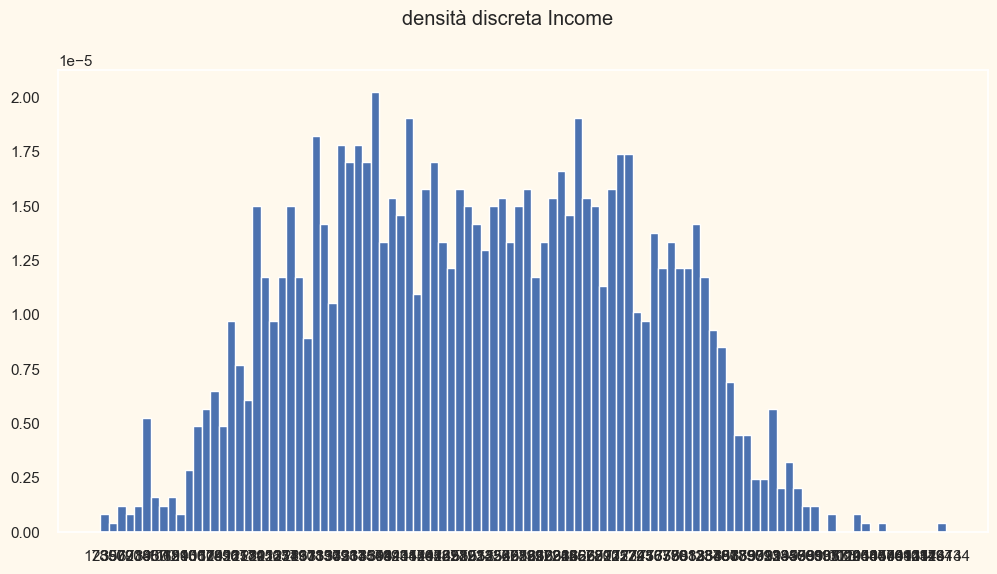

In [33]:
fig = plt.figure(figsize=(12,6))
binsIncome = list(np.arange(dataset["Income"].min(),dataset["Income"].max(),IncomeBinWidth))
#valori,bordi,_=plt.hist(dataset["Score"], bins=binsHappiness, width=happinessBinWidth, density=True)
valori,bordi,_=plt.hist(dataset["Income"], bins=100, density=True)
plt.xticks(bordi)
plt.grid()
fig.suptitle("densità discreta Income")
plt.show()

Let's have a look on the distribution of customer's age :


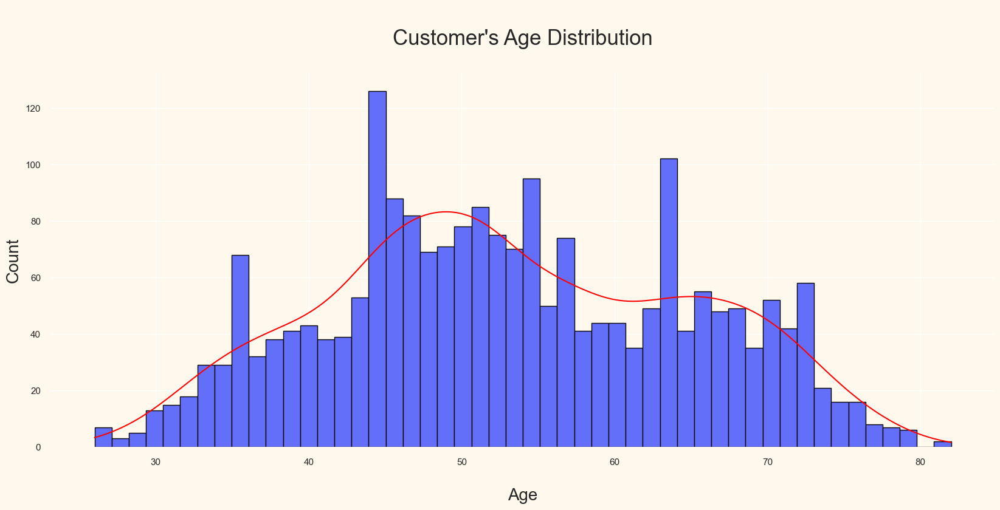

In [34]:
print(f"Let's have a look on the distribution of customer's age :")
plt.subplots(figsize=(20, 8))
p = sns.histplot(dataset["Age"],color="#636ef9",kde=True,bins=50,alpha=1,fill=True,edgecolor="black")
p.axes.lines[0].set_color("red")
p.axes.set_title("\nCustomer's Age Distribution\n",fontsize=25)
plt.ylabel("Count",fontsize=20)
plt.xlabel("\nAge",fontsize=20)
sns.despine(left=True, bottom=True)

plt.show()

Let's have a look on the distribution of Amount Spent :


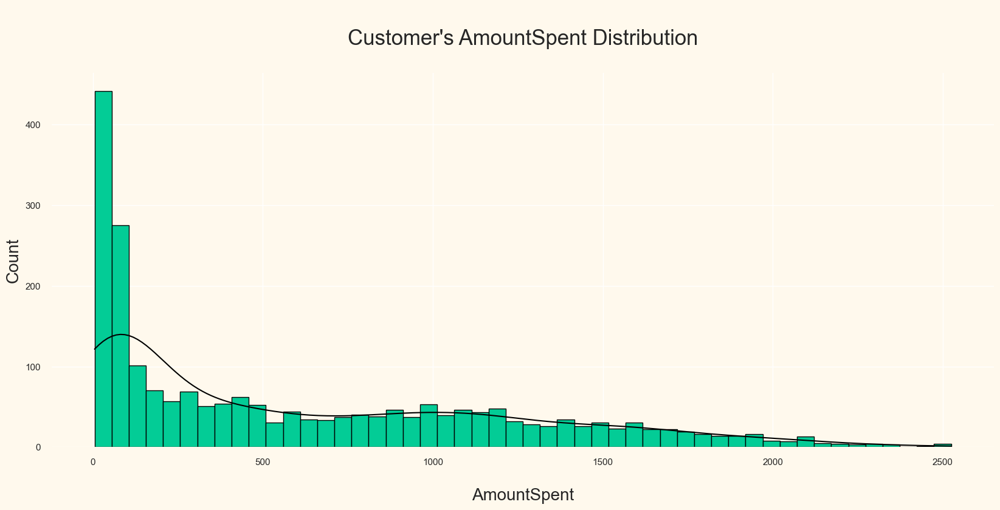

In [35]:
print(f"Let's have a look on the distribution of Amount Spent :")
plt.subplots(figsize=(20, 8))
p = sns.histplot(dataset["AmountSpent"],color="#03cc96",kde=True,bins=50,alpha=1,fill=True,edgecolor="black")
p.axes.lines[0].set_color("#000")
p.axes.set_title("\nCustomer's AmountSpent Distribution\n",fontsize=25)
plt.ylabel("Count",fontsize=20)
plt.xlabel("\nAmountSpent",fontsize=20)
sns.despine(left=True, bottom=True)

plt.show()

In [36]:
fig=make_subplots(rows=3,cols=2,subplot_titles=('<i>Age', '<i>Income', '<i>Amount Spent', '<i>Customer for', '<i>NumTotalPurchases'))
fig.add_trace(go.Histogram(x=dataset['Age'],name='Age'),row=1,col=1)
fig.add_trace(go.Histogram(x=dataset['Income'],name='Income'),row=1,col=2)
fig.add_trace(go.Histogram(x=dataset['AmountSpent'],name='AmountSpent'),row=2,col=1)
fig.add_trace(go.Histogram(x=dataset['Customer_For'],name='Customer_For'),row=2,col=2)
fig.add_trace(go.Histogram(x=dataset['NumTotalPurchases'],name='NumTotalPurchases'),row=3,col=1)


fig.update_layout(height=600, width=1000, title_text='<b>Histograms', font_size=20)
fig.update_layout(title_x=0.5, font_family='Courier New', showlegend=False)


<ul><li>La maggior parte del reddito dei clienti varia tra i 20000 e gli 80000</li>
    <li>Quasi tutti i clienti spendono pochissima parte del loro reddito.</li></ul>
<ul><li>Possiamo vedere che sia l'età che il reddito hanno una distribuzione normale. Nello specifico Income presenta una mixture di due distribuzioni normali.</li>
    <li>La maggior parte dei clienti sono da 40 a 50.</li>



In [37]:
fig = px.histogram(dataset, x="Income", color="Living_With", marginal="violin", )

fig.update_layout(title_text="Income vs Marital Status", title_x=0.5, height=500,
        font=dict(
            family="Rubik",
            size=14)
)

fig.show()

La maggior parte dei clienti vivono insieme.
I clienti che vivono insieme e sono genitori guadagnano molto e spendono molto.

In [38]:
fig = px.histogram(dataset, x="Income", color="Education", marginal="violin")

fig.update_layout(title_text="Income vs Education", title_x=0.5, height=500,
        font=dict(
            family="Rubik",
            size=14)
)

fig.show()

In [39]:
fig = px.histogram(dataset, x="AmountSpent", color="Education", marginal="violin")

fig.update_layout(title_text="AmountSpent vs Education", title_x=0.5, height=500,
        font=dict(
            family="Rubik",
            size=14)
)

fig.show()

La maggior parte della reddito del cliente del livello UG è fra 20000 a 80000 e la spesa fra 0 a 1400.
La maggior parte del livello di reddito del cliente PG è tra 20000 a 85000 e la spesa tra 0 a 2000.


In [40]:
fig = px.histogram(dataset, x="Income", color="Children", marginal="violin")

fig.update_layout(title_text="Income vs Children", title_x=0.5, height=500,
        font=dict(
            family="Rubik",
            size=14)
)

fig.show()

In [41]:
fig = px.scatter_3d(dataset, x='Income', y='Customer_For', z='AmountSpent',
                    color='NumTotalPurchases')
fig.update_layout(title='<b> 3D Scatter Plot <b>', title_x=0.5,
                  titlefont=dict({'size':28, 'family': 'Courier New', 'color':'white'}),
                  width=900, height=500,
                 )
fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="black",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="black"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="black"),
                              ),
                  )
fig.show()

In [42]:
#Get list of categorical variables
s = (dataset.dtypes == 'object')
object_cols = list(s[s].index)

print("Categorical variables in the dataset:", object_cols)

#Label Encoding the object dtypes.
LE=LabelEncoder()
for i in object_cols:
    dataset[i]=dataset[[i]].apply(LE.fit_transform)
    
print("All features are now numerical")

Categorical variables in the dataset: ['Education', 'Living_With']
All features are now numerical


### 4.3.1 QQ-Plot

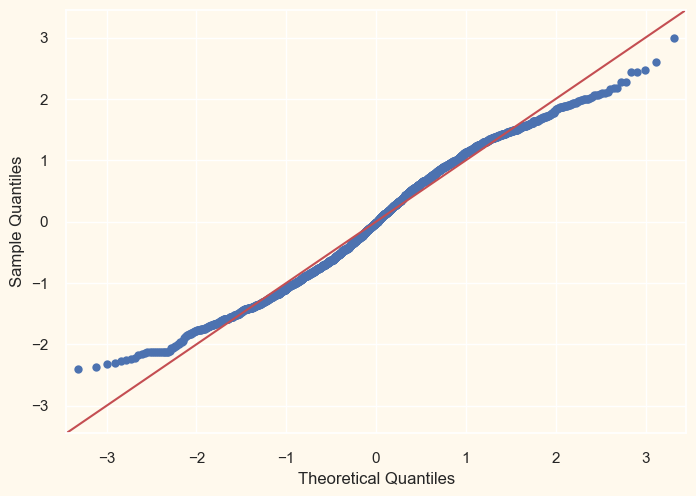

In [43]:
from statsmodels.graphics.gofplots import qqplot

qqplot(dataset["Income"], fit=True, line='45')
plt.show()

Come anticipato precedentemente la distribuzione segue una distribuzione quasi normale, nello specifico più una doppia distribuzione normale.<br>
Verrà ulteriolmente provato il fit alla distribuzione, cercando il miglior fit.


Per l'Income verranno provate le distribuzioni: Gaussiana, Bimodale.

Per la ricerca dei migliori parametri del fit verrà utilizzato il metodo della Maximum Likelihood Estimation(che è quello utilizzato dalle varie librerie).

Infine, per la ricerca della distribuzione che approssima meglio l'attributo verranno utilizzati dei test di goodness, in particolare verrà utilizzato il test di Kolmogorov-Smirnov e Shapiro.

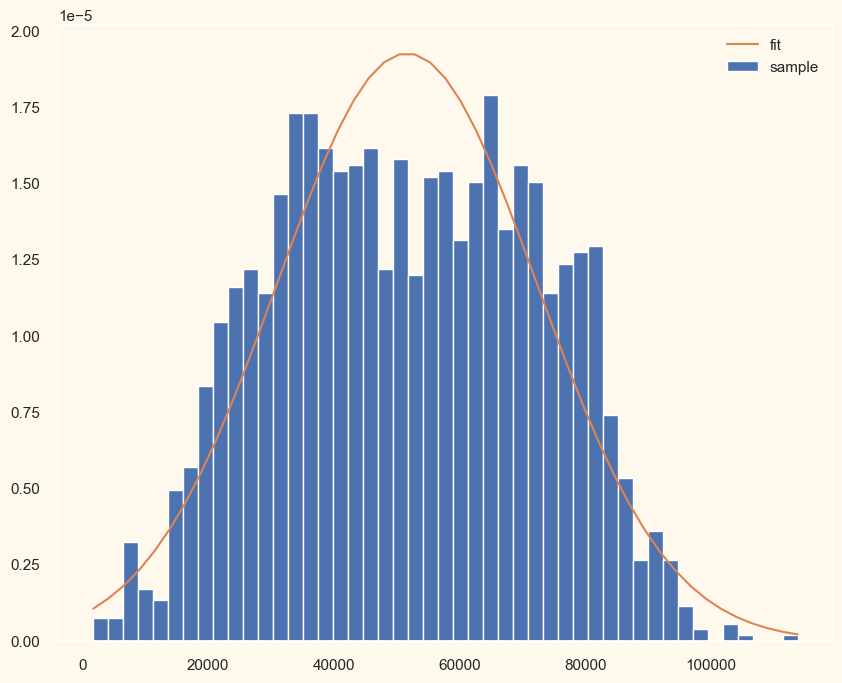

In [44]:
from scipy.stats import norm,poisson,exponweib,ks_2samp,kstest

n_binsIncome = math.ceil(math.sqrt(dataset["Income"].shape[0]+1))

plt.figure(figsize=(10,8))
g=norm(*norm.fit(dataset["Income"]))
x=np.linspace(dataset["Income"].min(),dataset["Income"].max(),n_binsIncome)
plt.hist(dataset["Income"],bins=n_binsIncome,density=True)
plt.plot(x,g.pdf(x))
plt.grid()
plt.legend(['fit','sample'])
plt.show()

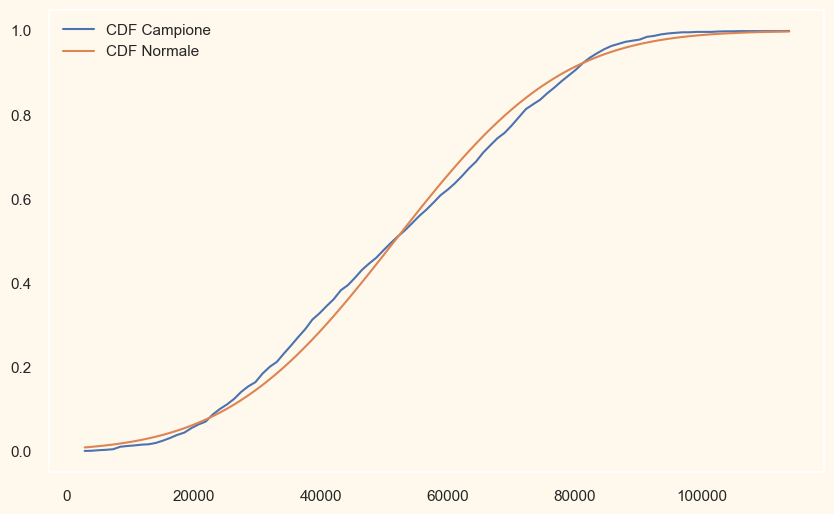

In [45]:
hist, bin_edges = np.histogram(dataset['Income'],bins=100,density=True)
cumsumIncome = np.cumsum(hist)
cumsumIncome = cumsumIncome/cumsumIncome[-1]

cumsumNorm = g.cdf(bin_edges[1:])

plt.figure(figsize=(10,6))
plt.plot(bin_edges[1:],cumsumIncome)
plt.plot(bin_edges[1:],cumsumNorm)
plt.grid()
plt.legend(['CDF Campione','CDF Normale'])
plt.show()

In [46]:
#import numpy as np
#from scipy.stats import norm, kstest

# Crea una distribuzione bimodale con medie 2 e 8 e deviazioni standard 3 e 5
#mean1, mean2 = 51622.094785, 51622.094785
#std1, std2 = 20713.063826, 20713.063826
#dist1 = norm(loc=mean1, scale=std1, size=1102)
#dist2 = norm(loc=mean2, scale=std2, size=1103)

# Definisci la CDF della distribuzione bimodale come la somma delle CDF delle distribuzioni normali
#bimodal_cdf = lambda x: (0.5 * dist1.cdf(x)) + (0.5 * dist2.cdf(x))


# Esegue il test di K-S utilizzando la distribuzione bimodale come distribuzione teorica
#KolmogorovSmirnov = kstest(dataset["Income"], bimodal_cdf, args=(mean,std))
#KSstatistic = KolmogorovSmirnov[0]
#pvalue = KolmogorovSmirnov[1]

#print(KSstatistic)
#print(pvalue)

In questo esempio, il test di KS viene eseguito utilizzando i dati generati dalla distribuzione  normale e la funzione di distribuzione cumulativa della distribuzione normale calcolata utilizzando le funzioni norm e norm.cdf. Il risultato del test viene stampato sullo schermo come il valore di ks_stat (la statistica di test di KS) e il p-value.


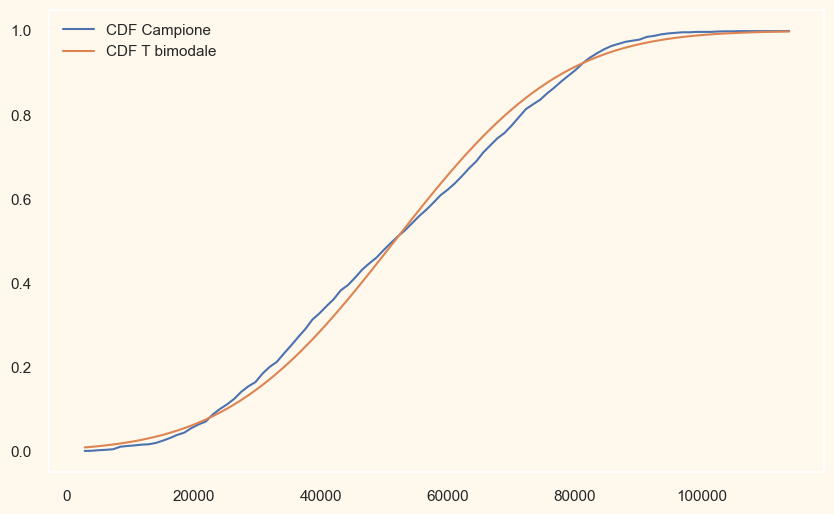

In [47]:
import scipy.stats as stats

mean, std = np.mean(dataset['Income']), np.std(dataset['Income'])
df = len(dataset['Income']) - 1  # degrees of freedom

t_dist = stats.t(df, mean, std)

# Per calcolare la CDF della distribuzione di Student t bimodale, puoi utilizzare il metodo .cdf() della distribuzione:

cumsumT = t_dist.cdf(bin_edges[1:])

# E poi puoi disegnare la CDF della distribuzione di Student t bimodale insieme alla CDF del campione utilizzando il codice che hai già scritto:

plt.figure(figsize=(10,6))
plt.plot(bin_edges[1:],cumsumIncome)
plt.plot(bin_edges[1:],cumsumT)
plt.grid()
plt.legend(['CDF Campione','CDF T bimodale'])
plt.show()



### 4.3.2 Kolmogorov-Smirnov

In [48]:
from scipy.stats import kstest, norm, shapiro, anderson

scaler = StandardScaler()
scaler.fit(dataset)
scaled_ds = pd.DataFrame(scaler.transform(dataset),columns= dataset.columns )



g=norm(*norm.fit(dataset["Income"]))
#KolmogorovSmirnov=kstest(dataset["Income"],"norm",args=g.args)
#Shapiro = shapiro(dataset["Income"].array)
#Anderson = anderson(dataset["Income"], dist='norm')


#print(KolmogorovSmirnov,"\n",Shapiro,"\n", Anderson)

In [49]:
from scipy.stats import kstest, norm
mean = 51622.094785
std = 20713.063826
size = 2205

norm_ = np.random.normal(loc=mean, scale=std, size=2205)

samples = np.random.normal(51622.094785, 20713.063826, 2205)
# Generate another 2205 samples from a normal distribution with mean 51622.094785 and std 20713.063826
samples2 = np.random.normal(51622.094785, 20713.063826, 2205)
# Combine the two sets of samples to create a bimodal distribution
bimodal = np.concatenate([samples, samples2])

g=norm(*norm.fit(dataset["Income"]))

KolmogorovSmirnov_norm = kstest(dataset["Income"], norm_, args=(mean,std))
KolmogorovSmirnov_bim = kstest(dataset["Income"], bimodal, args=(mean,std))


print("norm: {}\n bim: {}".format(KolmogorovSmirnov_norm, KolmogorovSmirnov_bim))

norm: KstestResult(statistic=0.042630385487528344, pvalue=0.03635511905189418)
 bim: KstestResult(statistic=0.048072562358276644, pvalue=0.002213081823807657)


In [50]:
scaler = StandardScaler()
scaler.fit(dataset)
scaled_ds = pd.DataFrame(scaler.transform(dataset),columns= dataset.columns )

scaled_ds.describe()

mean = 2.255691e-17
std = 1.000227e+00
size = 2205

norm_ = np.random.normal(loc=mean, scale=std, size=2205)

samples = np.random.normal(2.255691e-17, 1.000227e+00, 2205)
# Generate another 2205 samples from a normal distribution with mean 51622.094785 and std 20713.063826
samples2 = np.random.normal(2.255691e-17, 1.000227e+00, 2205)
# Combine the two sets of samples to create a bimodal distribution
bimodal = np.concatenate([samples, samples2])

g=norm(*norm.fit(dataset["Income"]))

KolmogorovSmirnov_norm = kstest(dataset["Income"], norm_, args=(mean,std))
KolmogorovSmirnov_bim = kstest(dataset["Income"], bimodal, args=(mean,std))


print("norm: {}\n bim: {}".format(KolmogorovSmirnov_norm, KolmogorovSmirnov_bim))


norm: KstestResult(statistic=1.0, pvalue=0.0)
 bim: KstestResult(statistic=1.0, pvalue=0.0)


## 4.4 Dipendenze nei dati

Successivamente vengono eliminate le ulteriori features che non sono di particolar innteresse. Infine verrà effettuato lo Scaler per la normalizzazionne dei valori dell'intero dataset.

In [51]:
#Dropping some of the redundant features
cols_del = ["Living_With","Kidhome", "Teenhome","Wines", "Fruits", "Meat", "Fish", "Sweets", "Gold", 
            "NumWebVisitsMonth", "NumWebPurchases","NumCatalogPurchases","NumStorePurchases",
            "NumDealsPurchases","AcceptedCmp1" , "AcceptedCmp2", "AcceptedCmp3" , "AcceptedCmp4","AcceptedCmp5", 
            "Response", "Recency", "Complain"]
ds = dataset.copy()
dataset = dataset.drop(cols_del, axis=1)

scaler = StandardScaler()
scaler.fit(dataset)
scaled_ds = pd.DataFrame(scaler.transform(dataset),columns= dataset.columns )
print("All features are now scaled")

All features are now scaled


In [52]:
dataset.head()

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases
0,1,58138.0,83894400000000000,65,1617,0,1,0,1,25
1,1,46344.0,10800000000000000,68,27,2,3,1,0,6
2,1,71613.0,40780800000000000,57,776,0,2,0,0,21
3,1,26646.0,5616000000000000,38,53,1,3,1,0,8
4,0,58293.0,27734400000000000,41,422,1,3,1,0,19


In [53]:
scaled_ds.head()

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases
0,0.943112,0.314651,1.974128,1.017189,1.679323,-1.266589,-1.759012,-1.58466,0.614920,1.328161
1,0.943112,-0.254877,-1.664957,1.273530,-0.963897,1.403420,0.448513,0.63105,-0.503808,-1.167390
2,0.943112,0.965354,-0.172330,0.333612,0.281242,-1.266589,-0.655250,-1.58466,-0.503808,0.802782
3,0.943112,-1.206087,-1.923048,-1.289883,-0.920675,0.068415,0.448513,0.63105,-0.503808,-0.904700
4,-1.060320,0.322136,-0.821859,-1.033542,-0.307248,0.068415,0.448513,0.63105,-0.503808,0.540092


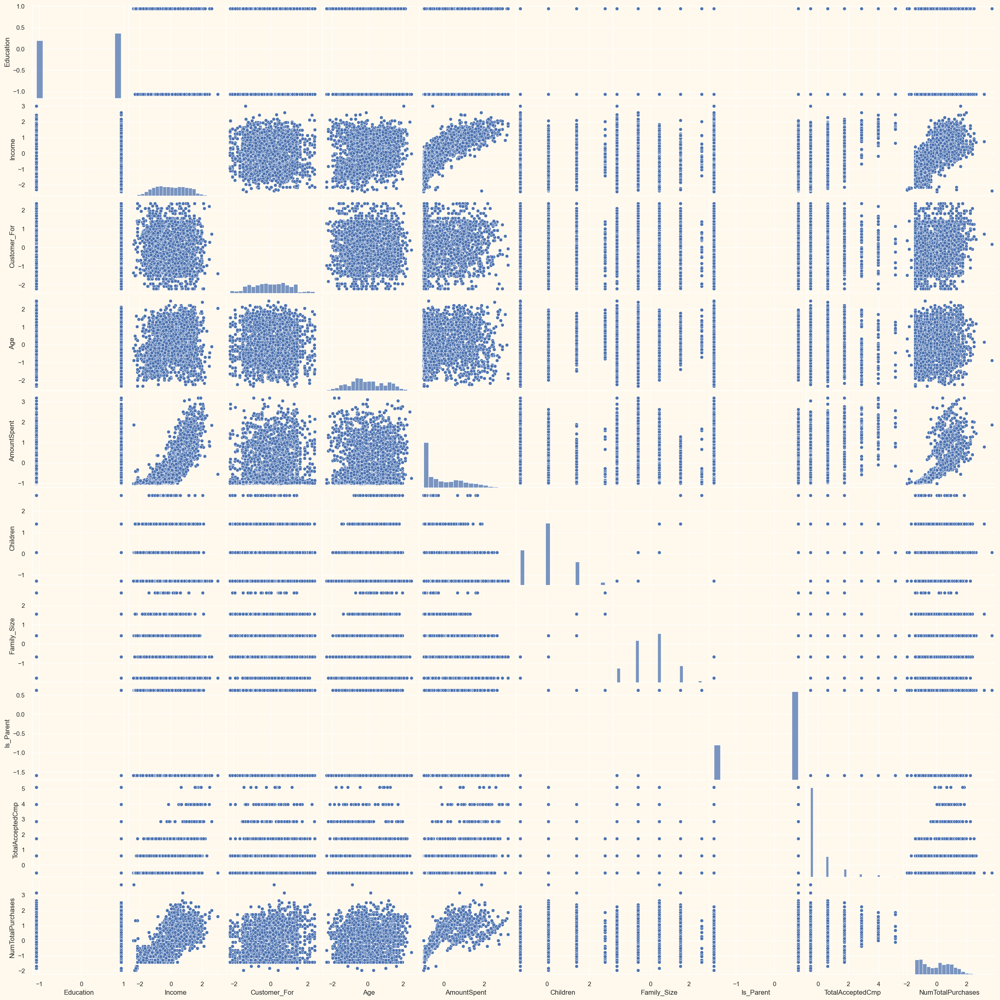

In [54]:
sns.pairplot(scaled_ds)

Si notano dei rapporti tra un paio di feature: in particolare si può vedere un collegamento tra AmountSpent e Income ,  o anche NumTotalPurchases con Income).

Altre feature invece non sembrano avere una vera correlazione.

Si procede quindi con l'analisi della covarianza.

In [55]:
scaled_ds.cov()

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases
Education,1.000454,-0.056548,0.030377,-0.097607,-0.017741,-0.034215,-0.034906,-0.005297,-0.026996,-0.034179
Income,-0.056548,1.000454,-0.031221,0.212722,0.824143,-0.350472,-0.296321,-0.410731,0.365706,0.701887
Customer_For,0.030377,-0.031221,1.000454,-0.020159,0.137537,-0.034994,-0.028825,-0.004877,0.056526,0.189318
Age,-0.097607,0.212722,-0.020159,1.000454,0.118458,0.093049,0.078940,-0.012018,-0.007374,0.186818
AmountSpent,-0.017741,0.824143,0.137537,0.118458,1.000454,-0.501110,-0.426208,-0.523471,0.455388,0.756301
Children,-0.034215,-0.350472,-0.034994,0.093049,-0.501110,1.000454,0.849808,0.799644,-0.255544,-0.250978
Family_Size,-0.034906,-0.296321,-0.028825,0.078940,-0.426208,0.849808,1.000454,0.692199,-0.242869,-0.206236
Is_Parent,-0.005297,-0.410731,-0.004877,-0.012018,-0.523471,0.799644,0.692199,1.000454,-0.295998,-0.223594
TotalAcceptedCmp,-0.026996,0.365706,0.056526,-0.007374,0.455388,-0.255544,-0.242869,-0.295998,1.000454,0.259559
NumTotalPurchases,-0.034179,0.701887,0.189318,0.186818,0.756301,-0.250978,-0.206236,-0.223594,0.259559,1.000454


come si vede c'è coerenza nelle correlazioni tra variabili, come si evince si vede che all'aumentare del reddito aumentano gli acquisti. Ulteriori variabili correlate sono le variabili family size con children e Is_parent, infatti sono correlati positivamente.

Non bisogna saltare comunque a conclusioni troppo affrettate sulla correlazione tra le varie variabili, dato che la correlazione può soltanto dire quanto siano correlate-dipendenti le feature coinvolte, ma la potenza della correlazione non è stata ancora analizzata.
Inoltre la covarianza non riesce a considerare casi dove le relazioni coinvolte siano più complicate, per esempio in relazioni non lineari o nella creazione di cluster tra le feature coinvolte.

**Si procede quindi con l'analisi della correlazione.**

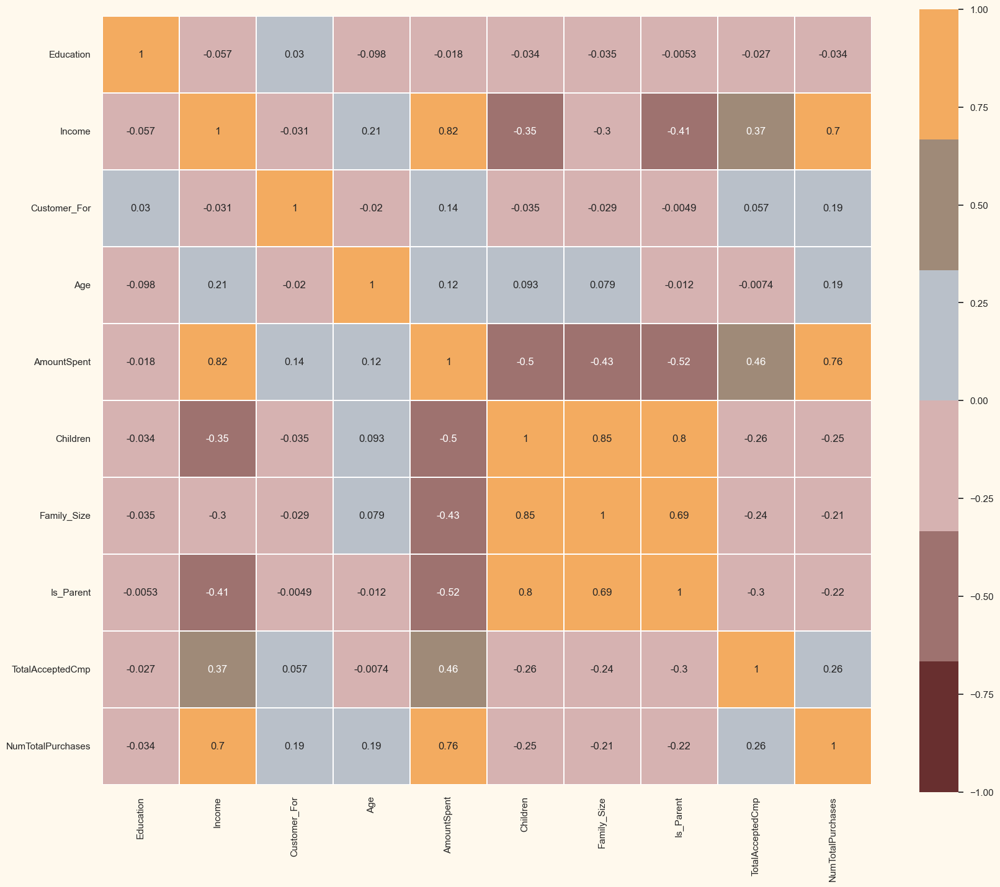

In [56]:
#correlation matrix
plt.subplots(figsize =(20, 20))

sns.heatmap(scaled_ds.corr(), cmap = cmap, square=True, cbar_kws=dict(shrink =.82), 
            annot=True, vmin=-1, vmax=1, linewidths=0.1,linecolor='white',annot_kws=dict(fontsize =12))

plt.xticks(rotation=90)
plt.show()

In [57]:
corr = scaled_ds.corr()
c1 = corr.abs().unstack()
c1.sort_values(ascending = False)[10:50:2]

Family_Size        Children             0.849422
AmountSpent        Income               0.823770
Children           Is_Parent            0.799282
NumTotalPurchases  AmountSpent          0.755958
                   Income               0.701568
Is_Parent          Family_Size          0.691885
AmountSpent        Is_Parent            0.523234
                   Children             0.500883
TotalAcceptedCmp   AmountSpent          0.455181
AmountSpent        Family_Size          0.426015
Is_Parent          Income               0.410545
TotalAcceptedCmp   Income               0.365540
Children           Income               0.350313
Family_Size        Income               0.296186
Is_Parent          TotalAcceptedCmp     0.295864
TotalAcceptedCmp   NumTotalPurchases    0.259441
Children           TotalAcceptedCmp     0.255428
                   NumTotalPurchases    0.250865
TotalAcceptedCmp   Family_Size          0.242759
Is_Parent          NumTotalPurchases    0.223493
dtype: float64

La funzione di pandas calcola l'indice di correlazione di Pearson di default. Si procederà dunque alla visualizzazione degli indici di Spearman e Kendall.

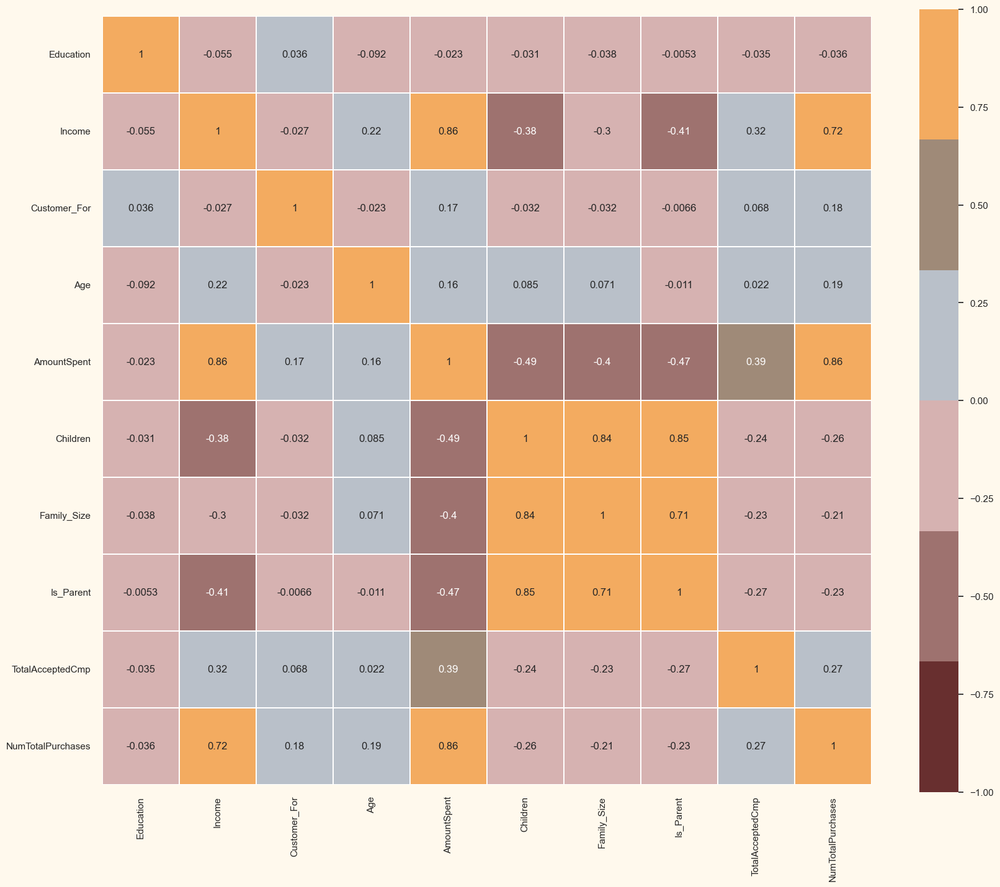

In [58]:
plt.subplots(figsize =(20, 20))

sns.heatmap(scaled_ds.corr(method="spearman"), cmap = cmap, square=True, cbar_kws=dict(shrink =.82), 
            annot=True, vmin=-1, vmax=1, linewidths=0.1,linecolor='white',annot_kws=dict(fontsize =12))

plt.xticks(rotation=90)
plt.show()

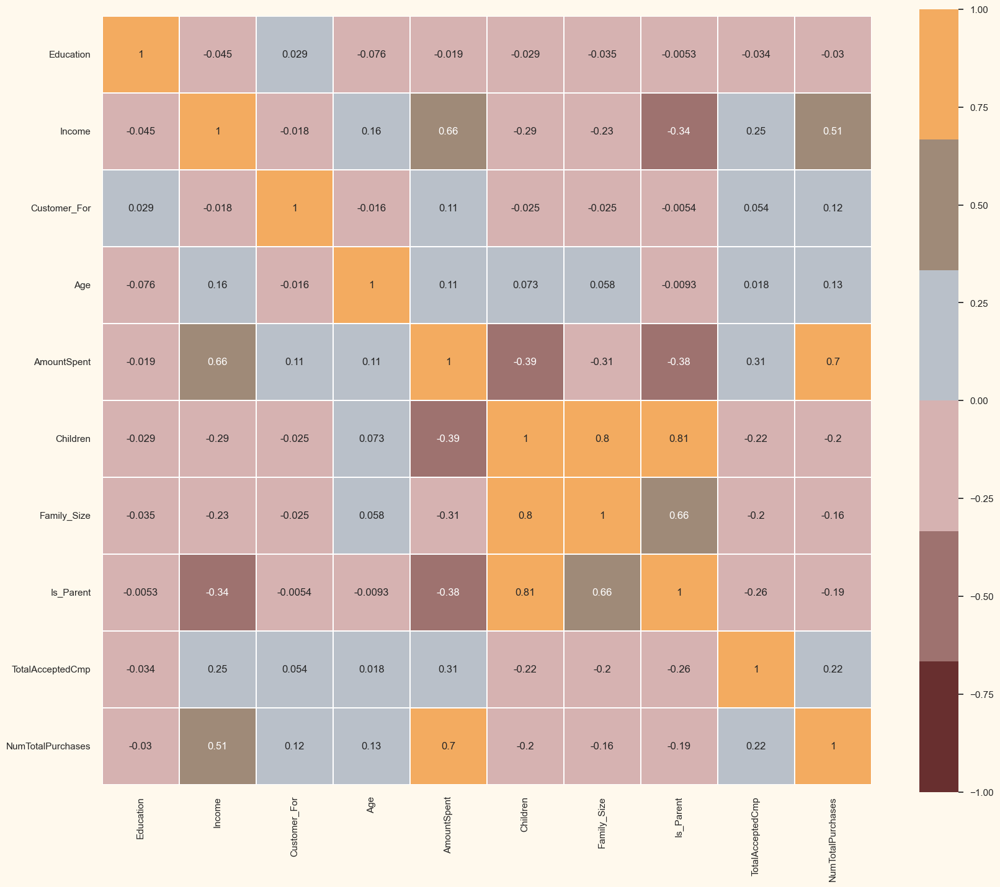

In [59]:
plt.subplots(figsize =(20, 20))

sns.heatmap(scaled_ds.corr(method="kendall"), cmap = cmap, square=True, cbar_kws=dict(shrink =.82), 
            annot=True, vmin=-1, vmax=1, linewidths=0.1,linecolor='white',annot_kws=dict(fontsize =12))

plt.xticks(rotation=90)
plt.show()

Si conclude che per abbastanza coppie di feature, tutti gli indici sembrano concordi con i risultati ottenuti.
Si ha dunque una correlazione tra le features: Income-AmountSpent-NumTotalPurchases e Children-Family_Size-Is_Parent.

## 4.5 Predizione tramite regressione


Durante l'analisi di regressione è possibile che alcune feature che inizialmente sembravano meno rilevanti possano rivelarsi utili per la predizione dell'attributo Income. Inoltre, anche se alcune feature non sono fortemente correlate con l'attributo da predire, potrebbero essere importanti per modellare le relazioni non lineari presenti nei dati. Pertanto, è spesso utile includere tutte le feature disponibili nell'analisi di regressione, almeno in una prima fase, per vedere quali sono quelle che contribuiscono maggiormente alla predizione dell'attributo di interesse. Se necessario, è sempre possibile escludere successivamente alcune feature dal modello, se si ritiene che non apportino significativi contributi alla predizione (come verrà effettuato il questo progetto=.

Vengono visti brevemente i plot più promettenti tra le feature che sembrano correlate:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot: xlabel='AmountSpent', ylabel='Income'>

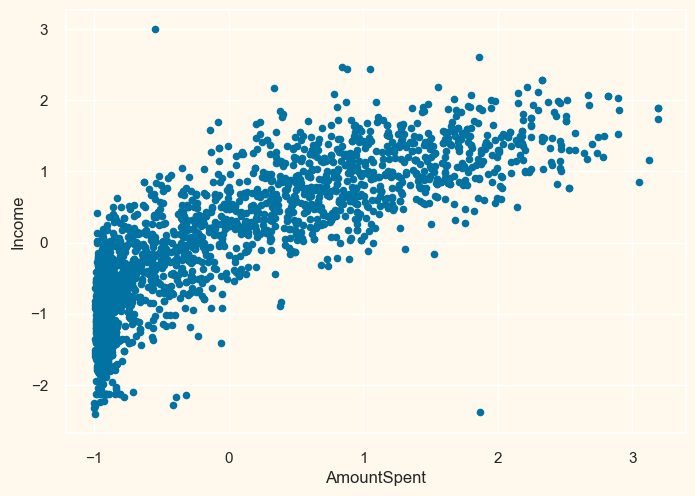

In [60]:
scaled_ds.plot.scatter(x="AmountSpent",y="Income")

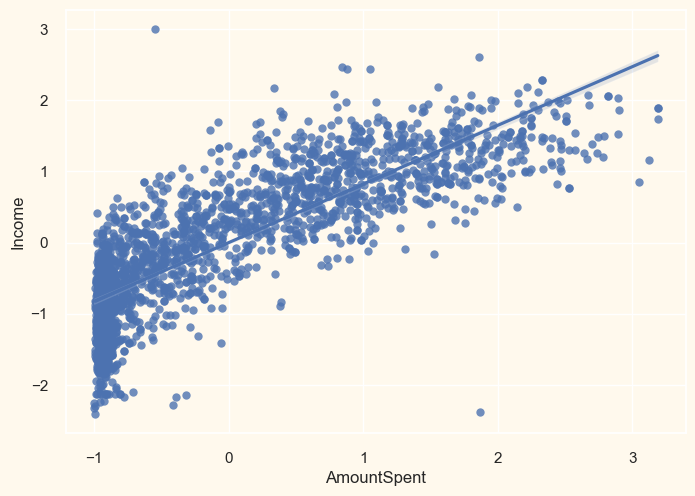

In [61]:
sns.regplot(scaled_ds,x='AmountSpent',y='Income')
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot: xlabel='NumTotalPurchases', ylabel='Income'>

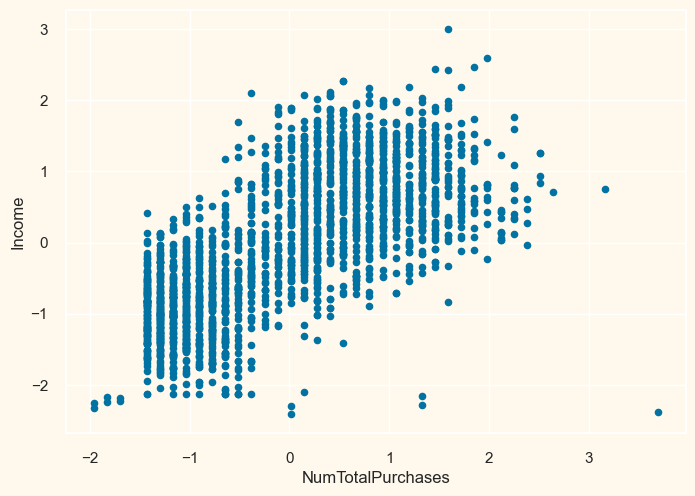

In [62]:
scaled_ds.plot.scatter(x="NumTotalPurchases",y="Income")

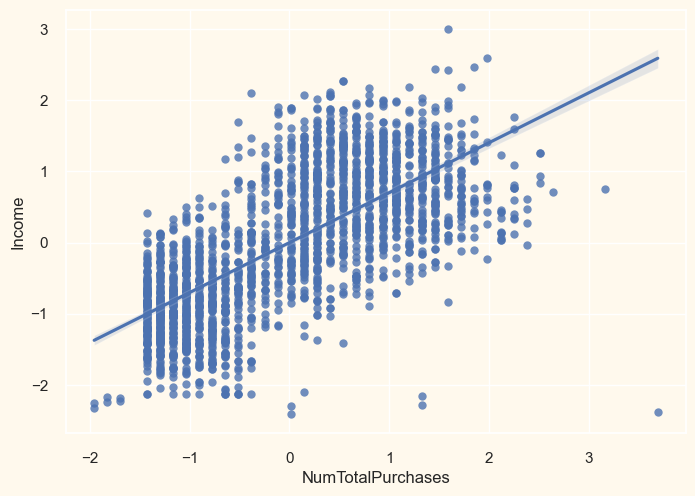

In [63]:
sns.regplot(scaled_ds,x='NumTotalPurchases',y='Income')
plt.show()

In [64]:
#from statsmodels.formula.api import ols
#model = ols("Income ~ AmountSpent + ",scaled_ds).fit()

##visualizziamo i parametri del modello
#model.params

In [65]:
#fitted = model.predict(scaled_ds["AmountSpent"])
#residuals = scaled_ds["Income"] - fitted
#numPredictors = 1
#RSS = np.sum(np.square(residuals))
#RSE = np.sqrt(RSS/(scaled_ds.shape[0]-numPredictors- 1))
#TSS = np.square(scaled_ds["Income"] - scaled_ds["Income"].mean()).sum()
#R2 = 1 - RSS/TSS
#print("RSS: ",RSS)
#print("RSE: ",RSE)
#print("TSS: ",TSS)
#print("R^2: ",R2)

In [66]:
#model.summary()

In [67]:
scaled_ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2205 entries, 0 to 2204
Data columns (total 10 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Education          2205 non-null   float64
 1   Income             2205 non-null   float64
 2   Customer_For       2205 non-null   float64
 3   Age                2205 non-null   float64
 4   AmountSpent        2205 non-null   float64
 5   Children           2205 non-null   float64
 6   Family_Size        2205 non-null   float64
 7   Is_Parent          2205 non-null   float64
 8   TotalAcceptedCmp   2205 non-null   float64
 9   NumTotalPurchases  2205 non-null   float64
dtypes: float64(10)
memory usage: 172.4 KB


In [68]:
#from statsmodels.api import OLS
from sklearn.model_selection import train_test_split

import statsmodels.api as sm

# Select the independent and dependent variables from the dataset
X = scaled_ds.drop(["Income"],axis=1)
y = scaled_ds["Income"]

# Add a constant term to the independent variables
X = sm.add_constant(X)

# Fit the model to the data
model = sm.OLS(y, X).fit()

# Print the summary of the model
print(model.summary())

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)


                            OLS Regression Results                            
Dep. Variable:                 Income   R-squared:                       0.732
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     665.6
Date:                Mon, 26 Dec 2022   Prob (F-statistic):               0.00
Time:                        04:44:48   Log-Likelihood:                -1677.7
No. Observations:                2205   AIC:                             3375.
Df Residuals:                    2195   BIC:                             3432.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const              2.233e-17      0.01

In [69]:
from sklearn.model_selection import KFold,cross_val_score,cross_val_predict
from sklearn import linear_model,metrics
lm = linear_model.LinearRegression()
kf = KFold(n_splits=10,shuffle=True)
scores = cross_val_score(lm, X, y, cv=kf)
predictions = cross_val_predict(lm, X, y, cv=kf)
print ("Cross-validated scores:", scores)
print('accuracy: ',(np.mean(scores)),"(", (np.std(scores)),")")
print("R2: ",metrics.r2_score(y, predictions))

Cross-validated scores: [0.7064145  0.71282955 0.74407926 0.73233459 0.71155819 0.75396604
 0.74828611 0.67914132 0.74902994 0.74482736]
accuracy:  0.7282466858400847 ( 0.023326986635783194 )
R2:  0.7286961013859812


Dal punteggio $R^2$ si può facilmente vedere come i risultati ottenuti sono accettabili, anche se non perfetti , infatti abbiamo un di 0.74.
Si procede quindi con una strategia di cross validation alla ricerca del modello migliore e dell'errore dei modelli creati per questo dataset. 

Il risultato finale che si ottiene è un 0.80.

<a id="5"></a>
# <div style="font-size:100%; font-family:Courier New; color: #000; line-height: 1;"><b>5. PCA Reduction</b></div>

### 5.1 PCA

In questo problema, ci sono molti fattori sulla base dei quali verrà effettuata la classificazione finale. Questi fattori sono fondamentalmente attributi o caratteristiche. Più è alto il numero di caratteristiche, più è difficile lavorarci. Molte di queste caratteristiche sono correlate e quindi ridondanti. Questo è il motivo per cui verrà  ridotta la dimensionalità sulle caratteristiche selezionate prima di passare alla fase di classificazione e clusterizzazione.
La riduzione dimensionale è il processo di riduzione del numero di variabili, ottenendo un insieme di nuove variabili principali.
Con la Principal component analisys lo spazio delle feature viene trasformato in un altro spazio dove i vettori di base (le nuove feature) sono ordinati per varianza decrescente e le feature sono decorrelate tra di loro (la matrice di covarianza risultante è diagonale).

Alla fine della procedura si avranno le componenti principali dei dati (delle basi ortonormali) e la matrice di trasformazione per il cambio di base.

La PCA è implementata nella libreria di scikit learn tramite Singular Value Decomposition.
Quindi verrà aumenntata l'interpretabilità ma allo stesso tempo minimizzata la perdita di informazioni.

Verrà utilizzata anche la tecnica LDA per ridurre le dimensionalità in maniera supervisionata (dopo aver effettuato la clusterizzazione). Questo perchè LDA tiene conto della classe d'appartenenza dei record.

In [70]:
#Initiating PCA to reduce dimentions aka features to 3
pca = PCA(n_components=7)
pca.fit(scaled_ds)
PCA_ds = pd.DataFrame(pca.transform(scaled_ds), columns=(["col1","col2", "col3","col4","col5","col6","col7"]))
PCA_ds.describe().T

print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.cumsum()[-1])


[0.3851042  0.16720118 0.10964888 0.09507039 0.08955451 0.07329604
 0.03293091]
0.9528061114729622


Il 91% della varianza viene mantenuta alla fine della trasformazione con 7 componenti principali.


Inizialmente il numero di PCA reduction era di 3 componenti. Di seguito vi è il grafico relativo alle 3 componenti:

In [71]:
x = PCA_ds["col1"]
y = PCA_ds["col2"]
z = PCA_ds["col3"]

print(f"Let's have a look on the dataset after dimensionality reduction :")

fig = go.Figure(data = [go.Scatter3d(x=x, y=y, z=z,mode='markers',
                marker = dict(size=10, color="#682F2F", opacity=0.8))])
fig.update_layout(title=dict(text= "Dataset After Diemsionality Reduction[3D Projection]",
                             y=0.97,x=0.5,xanchor= "center",yanchor= "top",font_color="black"),
                  scene=dict(xaxis = dict(title="col1",backgroundcolor="#D4C8BA",showbackground=True,showgrid=True, gridwidth=2, gridcolor='white',zerolinecolor="white"),
                             yaxis = dict(title="col2",backgroundcolor="#D4C8BA",showbackground=True,showgrid=True, gridwidth=2, gridcolor='white',zerolinecolor="white"),
                             zaxis = dict(title="col3",backgroundcolor="#D4C8BA",showbackground=True,showgrid=True, gridwidth=2, gridcolor='white',zerolinecolor="white")),
                  margin=dict(l=0, r=0, b=0, t=0),paper_bgcolor="#D4C8BA")
fig.show()

Let's have a look on the dataset after dimensionality reduction :


<a id="6"></a>
# <div style="font-size:100%; font-family:Courier New; color: #000; line-height: 1;"><b>6. Cluster</b></div>


Il clustering è un processo di «unsupervised learning» dove si vuole suddividere un insieme di dati in n classi (o cluster) senza alcuna conoscenza a-priori di quante e quali siano le classi e le loro
etichette, differente dalla classificazione che costruisce modelli di supervised learning.

Gli oggetti da raggruppare tramite clustering devono risiedere in uno spazio metrico oppure avere una sorta di funzione di distanza o similarità per permettere la costruzione del cluster (oltre al fatto che la distanza definita deve avere delle proprietà ben definite come la proprietà simmetrica e la triangolare). Per gli spazi euclidei la definizione di distanza potrebbe essere la solita distanza euclidea, ma esistono altre misure come la distanza di manhattan, del coseno.

Nel caso di spazi non euclidei, si devono definire delle metriche alternative che, più che la distanza, misurano la similarità tra gli oggetti.

Una classificazione degli algoritmi di clustering si basa sull’approccio utilizzato.
1) Metodi gerarchici o agglomerativi: ciascun punto viene inizialmente posto in un cluster diverso e successivamente i cluster vengono combinati tra loro secondo una nozione di «vicinanza» definita opportunamente. Il processo di aggregazione di cluster termina sulla base di un opportuno criterio di terminazione (ad es. raggiungimento di un numero di cluster desiderati).

2) Metodi di partizionamento: l’insieme dei punti viene partizionato in k cluster, in modo che ciascun punto appartenga ad uno e un solo cluster. Dopo aver stimato dei cluster iniziali, i punti vengono presi in considerazione seguendo un certo ordine e assegnati al cluster più «adatto». Alcuni varianti permettono di non assegnare un punto a nessun cluster se questo punto è un outlier (cioè è isolato e lontano dai vari cluster). Rappresentanti di questa categoria sono gli algoritmi K-means.

3) altri metodi basati su densità(DB-SCAN), griglia (quantizzazione dello spazio metrico), ibridi.

Esistono molti algoritmi di clusterizzazione che utilizzano più o meno tutti lo stesso concetto di centroide(clusteroide), cioè un punto(che può essere non appartenente al dataset oppure appartenente al dataset) che serva da identificatore del cluster e sia utilizzato durante la costruzione dei cluster.

Durante questo studio verrà utilizzato l'algoritmo k-means, un metodo di clustering per partizionamento.

Il fine ultimo di questa sezione è la ricerca di etichette da associare ai record e soprattutto di suddividere i clienti in gruppiche vanno da una scala di chi spende assai e quindi conviene inviargli pubblicità sui prodotti ecc.. e clienti che vanno alla ricerca dell'offerta e dunque capire chi sono quei clienti che comprano solo con le offerte.

Di segutio verranno utilizzati i metodi di Elbow e Silhouette per individuare il corretto numero di cluster k.

Elbow Method for determining the number of clusters :


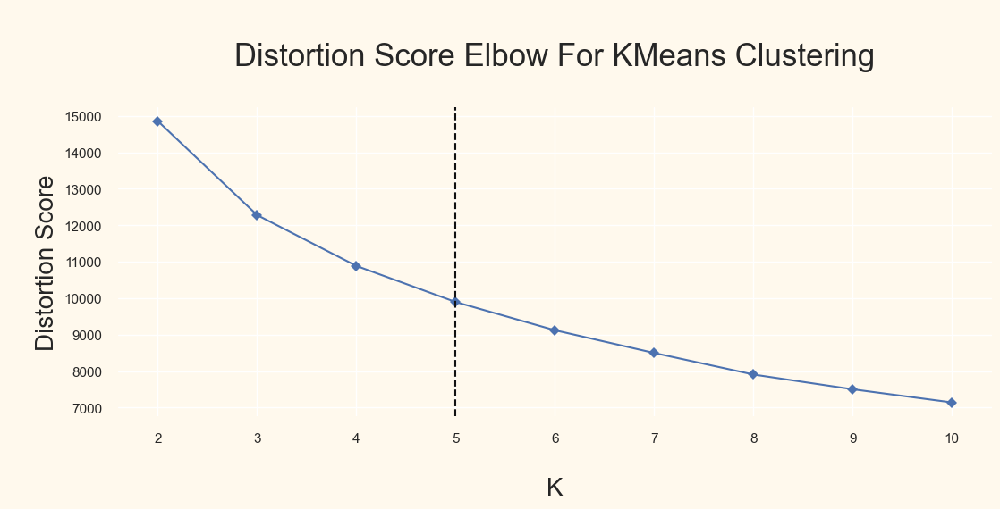

In [72]:
print("Elbow Method for determining the number of clusters :")
_, axes = plt.subplots(figsize=(20,8))

elbow = KElbowVisualizer(KMeans(), k=10, timings=False, locate_elbow=True, size=(1260,450))
elbow.fit(PCA_ds)

axes.set_title("\nDistortion Score Elbow For KMeans Clustering\n",fontsize=25)
axes.set_xlabel("\nK",fontsize=20)
axes.set_ylabel("\nDistortion Score",fontsize=20)

sns.despine(left=True, bottom=True)
plt.show()

Verrà utilizzato k = 4, quindi ci saranno quattro cluster nel nostro set di dati.
Useremo l'algoritmo KMeans per il clustering.

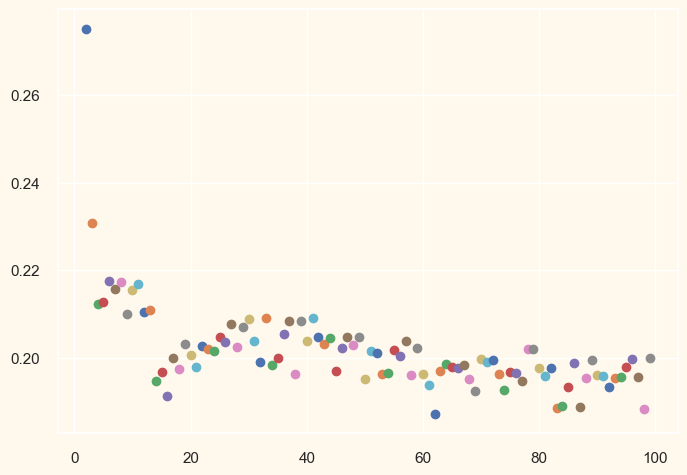

optimal number of clusters is : 2  with a silhouette avg of:  0.27513719767384265


In [73]:
from sklearn.metrics import silhouette_score

maxim=0
max_nclus=0

for n_clusters in range(2,100):
    clusterer = KMeans(n_clusters=n_clusters, random_state=30)
    cluster_labels = clusterer.fit_predict(PCA_ds)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(PCA_ds, cluster_labels)
    #print("For n_clusters =", n_clusters,"The average silhouette_score is :", silhouette_avg)
    plt.scatter(n_clusters,silhouette_avg)
    if(maxim<silhouette_avg): 
        maxim=silhouette_avg
        max_nclus=n_clusters
plt.show()
print("optimal number of clusters is :",max_nclus," with a silhouette avg of: ",maxim)


Come si evince dalle due metologie sopra utilizzate, il numero corretto di cluster per questo dataset è di 4. Si procede adesso con l'effettiva clusterizzazione dei dati

In [74]:
km = KMeans(n_clusters = 4,random_state = 42)

y_km = km.fit_predict(PCA_ds)
PCA_ds["Clusters"] = y_km
dataset["Clusters"]= y_km
scaled_ds["Clusters"]= y_km

PCA_ds.to_csv("PCA_ds.csv", sep='\t')
dataset.to_csv("dataset_cluster.csv", sep='\t')
scaled_ds.to_csv("scaled_ds_cluster.csv", sep='\t')

Let's have a look on the customers quantity distribution after clustering :


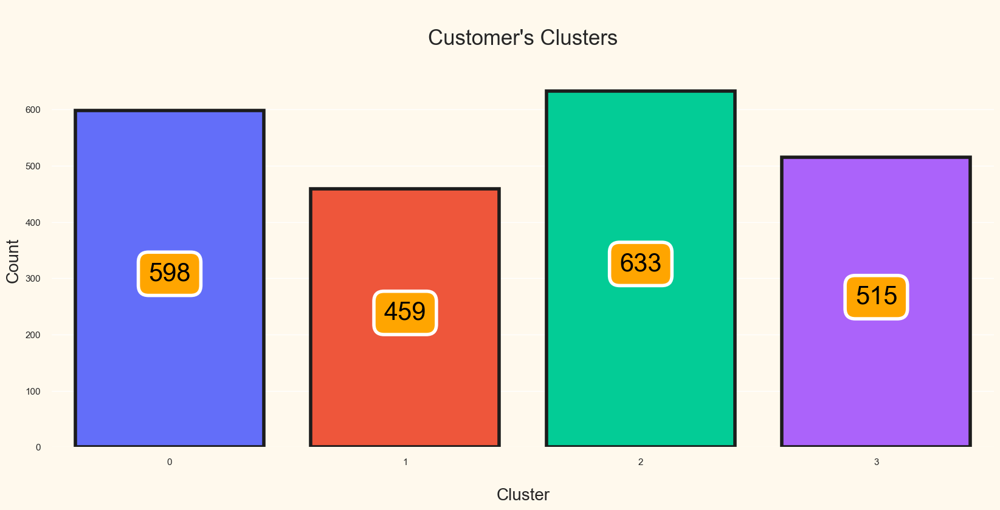

In [75]:
print("Let's have a look on the customers quantity distribution after clustering :")

plt.subplots(figsize=(20, 8))
p = sns.countplot(x=PCA_ds["Clusters"],palette=["#636ef9","#ee563b", "#03cc96","#ab63fa"], saturation=1,edgecolor = "#1c1c1c", linewidth = 4)
p.axes.set_yscale("linear")
p.axes.set_title("\nCustomer's Clusters\n",fontsize=25)
p.axes.set_ylabel("Count",fontsize=20)
p.axes.set_xlabel("\nCluster",fontsize=20)
p.axes.set_xticklabels(p.get_xticklabels(),rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type="center",padding=6,size=30,color="black",rotation=0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "orange", "edgecolor": "white", "linewidth" : 4, "alpha": 1})


sns.despine(left=True, bottom=True)


plt.show()

Si vede dunque il numero dei clienti diviso per cluster:

<ul>
<li>Cluster 0 has 538 customers.</li>
<li>Cluster 1 has the highest amount of 599 customers.</li>
<li>Cluster 2 has 509 customers.</li>
<li>Cluster 3 has 566 customers.</li></ul>

Non vi è dunque bisogno di fare un **RESAMPLE** delle classi per la classificazione perché le classi sono all'incirca popolati alla stessa maniera, non vi è nessun tipo di sbilanciamento.

In [76]:
print(f"Let's have a look on the dataset after clustering :")

fig = go.Figure(data = [go.Scatter3d(x=x, y=y, z=z,mode='markers',
                marker = dict(size=10, color=PCA_ds["Clusters"],colorscale=["#636ef9","#ee563b", "#03cc96","#ab63fa"], opacity=1))])
fig.update_layout(title=dict(text= "Dataset After Clustering[3D Projection]",
                             y=0.97,x=0.5,xanchor= "center",yanchor= "top",font_color="black"),
                  scene=dict(xaxis = dict(title="col1",backgroundcolor="#D4C8BA",showbackground=True,showgrid=True, gridwidth=2, gridcolor='white',zerolinecolor="white"),
                             yaxis = dict(title="col2",backgroundcolor="#D4C8BA",showbackground=True,showgrid=True, gridwidth=2, gridcolor='white',zerolinecolor="white"),
                             zaxis = dict(title="col3",backgroundcolor="#D4C8BA",showbackground=True,showgrid=True, gridwidth=2, gridcolor='white',zerolinecolor="white")),
                  margin=dict(l=0, r=0, b=0, t=0),paper_bgcolor="#D4C8BA")
fig.show()

Let's have a look on the dataset after clustering :


Si procede dunque con la visualizzazione dei cluster in base al reddito e all'ammontare della spesa per ogni cliente:

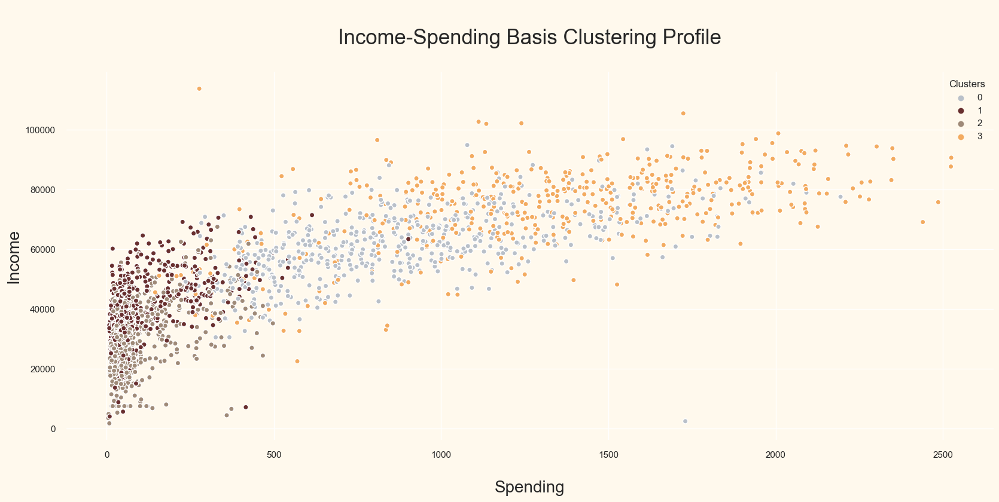

In [77]:
_, axes = plt.subplots(figsize=(20,8))
sns.scatterplot(x=dataset["AmountSpent"],y=dataset["Income"],hue=dataset["Clusters"],palette=["#B9C0C9","#682F2F", "#9F8A78","#F3AB60"],sizes=60, alpha=1, linewidth = 1)
axes.set_title("\nIncome-Spending Basis Clustering Profile\n",fontsize=25)
axes.set_ylabel("Income",fontsize=20)
axes.set_xlabel("\nSpending",fontsize=20)

sns.despine(left=True, bottom=True)
plt.show()



* La maggior parte del reddito dei clienti del cluster 0 è compresa tra 0 e 60000 e il range di spesa è compresa tra 0 e 500.
* La maggior parte dei clienti del cluster 1 ha un reddito è tra 20000 a 100000 e la spesa è tra 250 a 2500.
* La maggior parte del reddito dei clienti del cluster 2 è compresa tra 0 e 70000 e il range di spesa è compresa tra 0 e 550.
* La maggior parte del cluster 3 fascia di reddito dei clienti è compresa tra 40000 e 90000 e il range di spesa è compresa tra 250 e 2200.

**Il grafico delle entrate e delle spese mostrato dal modello dei cluster**
* gruppo 0: bassa spesa e basso reddito
* gruppo 1: elevata spesa e alto reddito
* gruppo 2: bassa spesa e reddito medio 
* gruppo 3: elevata spesa e reddito medio



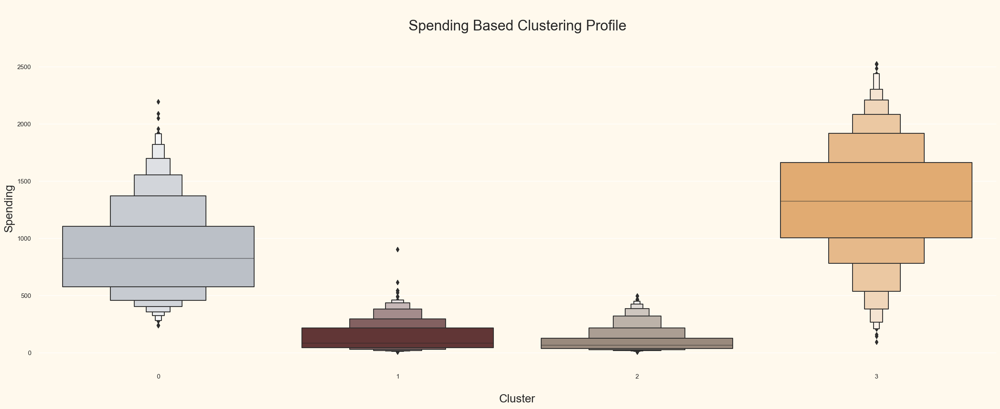

In [78]:
_, axes = plt.subplots(figsize=(30,10))
sns.boxenplot(x=dataset["Clusters"], y=dataset["AmountSpent"], palette=["#B9C0C9","#682F2F", "#9F8A78","#F3AB60"])

axes.set_title("\nSpending Based Clustering Profile\n",fontsize=25)
axes.set_ylabel("Spending",fontsize=20)
axes.set_xlabel("\nCluster",fontsize=20)

sns.despine(left=True, bottom=True)
plt.show()

Si procede infine con la visualizzazione dei cluster in base alle promozioni accettate:

Let's have a look on the characteristics of the clusters on the basis of accepting promotions :


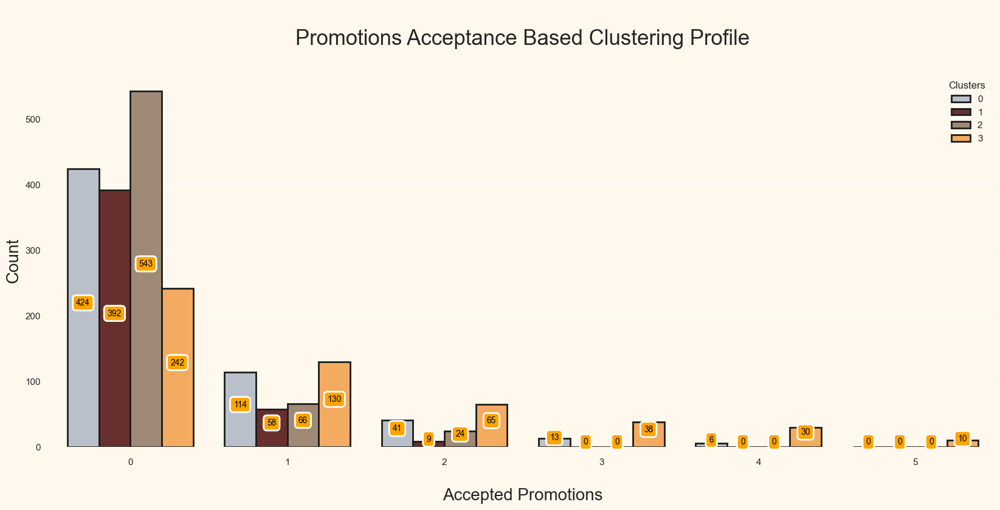

In [79]:
print(f"Let's have a look on the characteristics of the clusters on the basis of accepting promotions :")

plt.subplots(figsize=(20, 8))
p = sns.countplot(x=dataset["TotalAcceptedCmp"],hue=dataset["Clusters"],palette=["#B9C0C9","#682F2F", "#9F8A78","#F3AB60"], saturation=1,edgecolor = "#1c1c1c", linewidth = 2)
p.axes.set_yscale("linear")
p.axes.set_title("\nPromotions Acceptance Based Clustering Profile\n",fontsize=25)
p.axes.set_ylabel("Count",fontsize=20)
p.axes.set_xlabel("\nAccepted Promotions",fontsize=20)
p.axes.set_xticklabels(p.get_xticklabels(),rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type="center",padding=6,size=10,color="black",rotation=0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "orange", "edgecolor": "white", "linewidth" : 2, "alpha": 1})


sns.despine(left=True, bottom=True)
plt.show()

## Datasets for classification

Da qui verrano addestrati i classificatori sui i 6 dataset differenti generati:

* Original dataset = dataset
* PCA_ds on Original dataset = PCA_ds
* LDA_ds on Original dataset = LDA_ds
***
* Scaled dataset = scaled_ds
* PCA_ds on scaled dataset = scaled_ds_pca
* LDA_ds on scaled dataset = scaled_ds_lda

In [80]:
dataset

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases,Clusters
0,1,58138.0,83894400000000000,65,1617,0,1,0,1,25,3
1,1,46344.0,10800000000000000,68,27,2,3,1,0,6,1
2,1,71613.0,40780800000000000,57,776,0,2,0,0,21,3
3,1,26646.0,5616000000000000,38,53,1,3,1,0,8,2
4,0,58293.0,27734400000000000,41,422,1,3,1,0,19,0
...,...,...,...,...,...,...,...,...,...,...,...
2235,1,61223.0,46742400000000000,55,1341,1,3,1,0,18,0
2236,0,64014.0,5270400000000000,76,444,3,5,1,1,22,1
2237,1,56981.0,27216000000000000,41,1241,0,1,0,1,19,3
2238,0,69245.0,27302400000000000,66,843,1,3,1,0,23,0


In [81]:
from sklearn.decomposition import PCA
pca = PCA(n_components=4)
pca.fit(dataset)
PCA_ds = pd.DataFrame(pca.transform(dataset), columns = ['col1','col2','col3','col4'])
print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.cumsum()[-1])
PCA_ds["Clusters"] = y_km

PCA_ds

[1.00000000e+00 1.06251594e-24 2.64219588e-28 3.21659435e-31]
1.0000000000000002


,col1,col2,col3,col4,Clusters
0,3.965219e+16,7810.599683,659.025247,-13.819688,3
1,-3.344221e+16,-6363.533113,-289.073249,-14.044015,1
2,-3.461407e+15,19878.124042,-295.230159,-0.535793,3
3,-3.862621e+16,-26221.530450,236.662264,11.465551,2
4,-1.650781e+16,6134.860703,-264.554511,13.622336,0
...,...,...,...,...,...
2200,2.500193e+15,9696.018742,490.567481,-2.446367,0
2201,-3.897181e+16,11133.969287,-270.521661,-20.631737,1
2202,-1.702621e+16,4826.326357,588.316923,10.740446,3
2203,-1.693981e+16,17079.964740,-105.327597,-10.611166,0


In [82]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
LDAmodelTrans = LDA()
LDAmodelTrans.fit(dataset,dataset.Clusters)
LDA_ds = LDAmodelTrans.transform(dataset)
LDA_ds = pd.DataFrame(LDA_ds, columns = ['col1','col2','col3'])
LDA_ds["Clusters"] = y_km

LDA_ds.to_csv("LDA_ds.csv", sep='\t')

LDA_ds

,col1,col2,col3,Clusters
0,4.518327,0.053434,0.504590,3
1,-2.673948,-0.371905,-2.551607,1
2,3.682616,0.438699,-0.494342,3
3,-2.671006,1.596189,1.210369,2
4,-0.631301,-0.940243,1.221807,0
...,...,...,...,...
2200,0.316277,-1.412890,1.175984,0
2201,-1.566503,-4.149852,-5.193786,1
2202,3.677198,1.793720,0.237318,3
2203,0.394217,-2.618941,0.750263,0


In [83]:
scaler = StandardScaler()
scaled_ds = pd.DataFrame(scaler.fit_transform(dataset.drop(["Clusters"],axis=1)),columns = dataset.drop(["Clusters"],axis=1).columns)
scaled_ds["Clusters"] = y_km
scaled_ds.head()

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases,Clusters
0,0.943112,0.314651,1.974128,1.017189,1.679323,-1.266589,-1.759012,-1.58466,0.614920,1.328161,3
1,0.943112,-0.254877,-1.664957,1.273530,-0.963897,1.403420,0.448513,0.63105,-0.503808,-1.167390,1
2,0.943112,0.965354,-0.172330,0.333612,0.281242,-1.266589,-0.655250,-1.58466,-0.503808,0.802782,3
3,0.943112,-1.206087,-1.923048,-1.289883,-0.920675,0.068415,0.448513,0.63105,-0.503808,-0.904700,2
4,-1.060320,0.322136,-0.821859,-1.033542,-0.307248,0.068415,0.448513,0.63105,-0.503808,0.540092,0


In [84]:
from sklearn.decomposition import PCA
pca = PCA(n_components=6)
pca.fit(scaled_ds)
scaled_ds_pca = pd.DataFrame(pca.transform(scaled_ds), columns = ['col1','col2','col3','col4','col5','col6'])
print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.cumsum()[-1])
scaled_ds_pca["Clusters"] = y_km

scaled_ds_pca

[0.37237938 0.19866231 0.09872052 0.08472827 0.07955468 0.06757882]
0.9016239736953966


,col1,col2,col3,col4,col5,col6,Clusters
0,3.705532,0.190647,1.443651,0.471654,-1.642876,0.932576,3
1,-2.110904,-0.231679,-1.287960,-1.783312,-0.489893,0.782269,1
2,2.473023,-0.657346,-0.000014,-0.917239,-1.070566,-0.264564,3
3,-1.466212,-2.005426,-0.230134,-1.591342,0.961077,-0.602862,2
4,-1.007125,0.885878,-0.512086,0.184317,0.965577,-1.672690,0
...,...,...,...,...,...,...,...
2200,-0.361766,1.684024,0.761602,-0.931701,-0.343219,-0.517156,0
2201,-2.186009,2.558428,-2.742004,-0.684476,0.865159,1.269640,1
2202,3.140158,-1.369829,0.361515,-1.081436,0.516189,-0.448331,3
2203,-0.416847,2.202769,-1.430551,-0.056732,-0.315092,-0.802423,0


In [85]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
LDAmodelTrans = LDA()
LDAmodelTrans.fit(scaled_ds,scaled_ds.Clusters)
scaled_ds_lda = LDAmodelTrans.transform(scaled_ds)
scaled_ds_lda = pd.DataFrame(scaled_ds_lda, columns = ['col1','col2','col3'])
scaled_ds_lda["Clusters"] = y_km

scaled_ds_lda.to_csv("scaled_ds_lda.csv", sep='\t')

scaled_ds_lda

,col1,col2,col3,Clusters
0,4.518327,0.053434,0.504590,3
1,-2.673948,-0.371905,-2.551607,1
2,3.682616,0.438699,-0.494342,3
3,-2.671006,1.596189,1.210369,2
4,-0.631301,-0.940243,1.221807,0
...,...,...,...,...
2200,0.316277,-1.412890,1.175984,0
2201,-1.566503,-4.149852,-5.193786,1
2202,3.677198,1.793720,0.237318,3
2203,0.394217,-2.618941,0.750263,0


## 8. CLASSIFICATION

In questa sezione si cercherà di costruire i modelli per classificare l'appartenenza dei record alle classi.

Alla fine della creazione di tutti i modelli verranno confrontati tramite le misure di accuratezza del singolo classificatore, oltre a vedere il comportamento dei singoli su dati che non siano del training set tramite validazione del modello (tramite cross-validation con k-folding).

### 8.1 Logistic Regression 

La regressione logistica è una regressione di tipo non lineare utilizzata molto per la classificazione di variabili di tipo binario, ma può essere facilmente estesa a variabili qualitative non binarie.

Per il caso binario, la funzione logit è il logaritmo naturale dell'**odd**, ovvero del rapporto $\frac{p}{1-p}$.

La probabilità viene definita come la sigmoide della funzione lineare di parametri stimati, cioè $p = sigm (\beta_0 + \beta_1 x)= \frac{e^{\beta_0 + \beta_1 x}}{1+e^{\beta_0+\beta_1 x}}$ .

E' importante notare che la derivata prima della sigmoide è una funzione a forma di campana, infatti la regressione logistica è molto utile per la predizione di dati che seguono una distribuzione normale.

Di seguito viene visto il codice per la costruzione della regressione logistica multinomiale.

#### 8.1.1 Original dataset

In [86]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split

ds = dataset.copy()
to_drop = ["Customer_For","Is_Parent","Children","Income"]
ds = ds.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)

modelLogit = LogisticRegression(multi_class='multinomial', solver='lbfgs')

modelLogit.fit(X_train,y_train )
predictedLogit = modelLogit.predict(X_test)
acc = accuracy_score(y_test, predictedLogit)
cm = confusion_matrix(y_test, predictedLogit)
print("Original dataset:")
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLogit))


Original dataset:
[[93  3  9 11]
 [ 2 50 33  0]
 [10 31 91  0]
 [22  2  0 84]]
Accuracy: 0.72
              precision    recall  f1-score   support

           0       0.73      0.80      0.77       116
           1       0.58      0.59      0.58        85
           2       0.68      0.69      0.69       132
           3       0.88      0.78      0.83       108

    accuracy                           0.72       441
   macro avg       0.72      0.71      0.72       441
weighted avg       0.73      0.72      0.72       441



Si vedono la matrice di confusione e degli indici statistici che esprimono l'accuratezza del modello, in particolare verrà posta particolare attenzione ad accuratezza (definita come record correttamente classificati in rapporto a tutti i record), precision(record classificati ed appartenenti effettivamente ad una classe in rapporto a tutti i record classificati con quella classe), recall(record classificati ed appartenenti ad una classe in rapporto a tutti i record effettivi di quella classe) ed f1-score(la media armonica tra precision e recall).

L'algoritmo di sklearn utilizza già una strategia di regolarizzazione dei parametri (L2) per evitare overfitting, si può comunque stabilire sia la strategia di regolarizzazione che il coefficentie di penalizzazione (come nelle SVM).

L'algoritmo originario di regressione logistica originario è stato fatto per considerare solo due classi (risposta binaria di appartenenza alle due classi), quello utilizzato da sklearn per la regressione logistica multinomiale calcola le probabilità che un record appartenga ad una classe specifica e poi decide con quale classe identificare il record tramite l'algoritmo di SoftMax (utilizzato anche nelle reti neurali per la classificazione all'ultimo livello), un caso speciale della sigmoide utilizzata nella regressione logistica per il calcolo delle probabilità.

Infine si decide la classe grazie alle probabilità ottenute (molto semplicemente la classe derivante è quella più probabile).

Nel modello precedente la predizione della classe viene effettuata sulle feature con la correlazione più alta.

#### 8.1.2 PCA original dataset

In [87]:
X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)

modelLogit = LogisticRegression(multi_class='multinomial', solver='lbfgs')

modelLogit.fit(X_train,y_train )
predictedLogit = modelLogit.predict(X_test)
acc = accuracy_score(y_test, predictedLogit)
cm = confusion_matrix(y_test, predictedLogit)
print("PCA_ds original dataset:")
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLogit))

PCA_ds original dataset:
[[74 42  0  0]
 [38 47  0  0]
 [73 59  0  0]
 [55 53  0  0]]
Accuracy: 0.27
              precision    recall  f1-score   support

           0       0.31      0.64      0.42       116
           1       0.23      0.55      0.33        85
           2       0.00      0.00      0.00       132
           3       0.00      0.00      0.00       108

    accuracy                           0.27       441
   macro avg       0.14      0.30      0.19       441
weighted avg       0.13      0.27      0.17       441



#### 8.1.3 LDA original dataset

In [88]:


X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)

modelLogit = LogisticRegression(multi_class='multinomial', solver='lbfgs')

modelLogit.fit(X_train,y_train )
predictedLogit = modelLogit.predict(X_test)
acc = accuracy_score(y_test, predictedLogit)
cm = confusion_matrix(y_test, predictedLogit)
print("LDA_ds original dataset:")
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLogit))

LDA_ds original dataset:
[[111   3   2   0]
 [  2  81   2   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.94      0.96      0.95       116
           1       0.93      0.95      0.94        85
           2       0.97      0.94      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



#### 8.1.4 Scaled dataset

Dopo svariati tentativi con i vari dataset , ma soprattutto con l'omissione dei vari attributi si è arrivati alla conclusione che eliminando i seguenti attributi si ottengono le migliori prestazioni con la regressione logistica 

In [89]:
ds_scaled = scaled_ds.copy()
to_drop = ["Customer_For","Is_Parent","Children","Income"]
ds_scaled = ds_scaled.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)

modelLogit = LogisticRegression(multi_class='multinomial', solver='lbfgs')

modelLogit.fit(X_train,y_train)
predictedLogit = modelLogit.predict(X_test)
acc = accuracy_score(y_test, predictedLogit)
cm = confusion_matrix(y_test, predictedLogit)
print("Scaled dataset:")
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLogit))

Scaled dataset:
[[103   2   0  11]
 [  3  73   9   0]
 [  2   5 125   0]
 [ 10   1   2  95]]
Accuracy: 0.90
              precision    recall  f1-score   support

           0       0.87      0.89      0.88       116
           1       0.90      0.86      0.88        85
           2       0.92      0.95      0.93       132
           3       0.90      0.88      0.89       108

    accuracy                           0.90       441
   macro avg       0.90      0.89      0.90       441
weighted avg       0.90      0.90      0.90       441



#### 8.1.5 PCA scaled dataset

In [90]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)

modelLogit = LogisticRegression(multi_class='multinomial', solver='lbfgs')

modelLogit.fit(X_train,y_train )
predictedLogit = modelLogit.predict(X_test)
acc = accuracy_score(y_test, predictedLogit)
cm = confusion_matrix(y_test, predictedLogit)
print("PCA_ds scaled dataset:")
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLogit))

PCA_ds scaled dataset:
[[115   1   0   0]
 [  1  84   0   0]
 [  0   0 132   0]
 [  0   0   0 108]]
Accuracy: 1.00
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       116
           1       0.99      0.99      0.99        85
           2       1.00      1.00      1.00       132
           3       1.00      1.00      1.00       108

    accuracy                           1.00       441
   macro avg       0.99      0.99      0.99       441
weighted avg       1.00      1.00      1.00       441



#### 8.1.6 LDA scaled dataset

In [91]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_lda.Clusters,test_size=0.2, random_state=42)

modelLogit = LogisticRegression(multi_class='multinomial', solver='lbfgs')

modelLogit.fit(X_train,y_train )
predictedLogit = modelLogit.predict(X_test)
acc = accuracy_score(y_test, predictedLogit)
cm = confusion_matrix(y_test, predictedLogit)
print("LDA_ds scaled dataset:")
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLogit))

LDA_ds scaled dataset:
[[111   3   2   0]
 [  2  81   2   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.94      0.96      0.95       116
           1       0.93      0.95      0.94        85
           2       0.97      0.94      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



I risultati migliori per la regressione logitstica si ottengono con i dataset scalati, precisamente sia con PCA che LDA.

### 8. 2 Naive Bayes

Il classificatore Naive Bayes si basa sull'interpretazione Bayesiana di probabilità e della probabilità condizionata riassunta nella seguente formula:

\begin{equation}
P(Y\ |\ X) = \frac{P(X\ |\ Y)\ P(Y)}{P(X)}
\end{equation}

Dove $P(X\ |\ Y)$ viene detta likelihood e $P(Y)$ probabilità a priori.

Questi concetti tornano molto utili nella classificazione dato che è possibile costruire un modello supervisionato dai dati di training già etichettati che riesca ad estimare la classe di appartenenza a partire dalle variabili indipendenti (gli estimatori).

Per semplificare il calcolo, si suppone l'indipendenza dei predittori, in modo che il calcolo della likelihood si riduca ad una produttoria delle singole probabilità condizionate dalla variabile dipendente da stimare.

In caso di variabili continue, si stima la likelihood secondo delle distribuzioni precise, tra le quali la più famosa è la distribuzione Gaussiana con la seguente formula di PDF : 
\\[p(x=v|C_k)=\frac{e^{-\frac{(v-\mu_k)^2}{2\sigma_k^2}}}{\sqrt[2]{2\pi\sigma_k^2}}\\]

La classificazione avviene infine prendendo la classe più probabile tramite la strategia di MAP.

Di seguito vengono presentati i codici per la costruzione di classificatori con Naive Bayes.

#### 8.2.1 Dataset original

In [92]:
from sklearn.naive_bayes import GaussianNB,CategoricalNB

X_train, X_test, y_train, y_test = train_test_split(dataset.drop(["Clusters"],axis=1), dataset.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[60 11 45  0]
 [29 13 43  0]
 [61 17 54  0]
 [48 23 37  0]]
Accuracy: 0.29
              precision    recall  f1-score   support

           0       0.30      0.52      0.38       116
           1       0.20      0.15      0.17        85
           2       0.30      0.41      0.35       132
           3       0.00      0.00      0.00       108

    accuracy                           0.29       441
   macro avg       0.20      0.27      0.23       441
weighted avg       0.21      0.29      0.24       441



#### 8.2.2 Dataset original with dropping

In [93]:
from sklearn.naive_bayes import GaussianNB,CategoricalNB

ds = dataset.copy()
to_drop = ["Customer_For","Is_Parent"]
ds = ds.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[104   5   0   7]
 [  4  75   6   0]
 [  5   7 120   0]
 [  5   2   0 101]]
Accuracy: 0.91
              precision    recall  f1-score   support

           0       0.88      0.90      0.89       116
           1       0.84      0.88      0.86        85
           2       0.95      0.91      0.93       132
           3       0.94      0.94      0.94       108

    accuracy                           0.91       441
   macro avg       0.90      0.91      0.90       441
weighted avg       0.91      0.91      0.91       441



#### 8.2.3 PCA dataset original

In [94]:
X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[60 11 45  0]
 [29 13 43  0]
 [61 17 54  0]
 [48 23 37  0]]
Accuracy: 0.29
              precision    recall  f1-score   support

           0       0.30      0.52      0.38       116
           1       0.20      0.15      0.17        85
           2       0.30      0.41      0.35       132
           3       0.00      0.00      0.00       108

    accuracy                           0.29       441
   macro avg       0.20      0.27      0.23       441
weighted avg       0.21      0.29      0.24       441



#### 8.2.4 LDA dataset original

In [95]:
X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[111   1   4   0]
 [  3  72  10   0]
 [  3   1 128   0]
 [  0   0   0 108]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.95      0.96      0.95       116
           1       0.97      0.85      0.91        85
           2       0.90      0.97      0.93       132
           3       1.00      1.00      1.00       108

    accuracy                           0.95       441
   macro avg       0.96      0.94      0.95       441
weighted avg       0.95      0.95      0.95       441



#### 8.2.5 Scaled dataset

In [96]:
ds_scaled = scaled_ds.copy()
to_drop = ["Customer_For","Is_Parent"]
ds_scaled = ds_scaled.drop(to_drop, axis=1)


X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[114   1   1   0]
 [  2  76   7   0]
 [  6   3 122   1]
 [  0   0   0 108]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.93      0.98      0.96       116
           1       0.95      0.89      0.92        85
           2       0.94      0.92      0.93       132
           3       0.99      1.00      1.00       108

    accuracy                           0.95       441
   macro avg       0.95      0.95      0.95       441
weighted avg       0.95      0.95      0.95       441



#### 8.2.6 PCA scaled dataset

In [97]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[115   1   0   0]
 [  4  81   0   0]
 [  0   0 131   1]
 [  0   0   0 108]]
Accuracy: 0.99
              precision    recall  f1-score   support

           0       0.97      0.99      0.98       116
           1       0.99      0.95      0.97        85
           2       1.00      0.99      1.00       132
           3       0.99      1.00      1.00       108

    accuracy                           0.99       441
   macro avg       0.99      0.98      0.99       441
weighted avg       0.99      0.99      0.99       441



#### 8.2.7 LDA scaled dataset

In [98]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_lda.Clusters,test_size=0.2, random_state=42)

#probabilità a priori uniformi
#modelNBgaussian = GaussianNB(priors=[0.25,0.25,0.25,0.25])
modelNBgaussian = GaussianNB()
modelNBgaussian.fit(X_train,y_train)

predictedNBGaussian = modelNBgaussian.predict(X_test)
acc = accuracy_score(y_test, predictedNBGaussian)
cm = confusion_matrix(y_test, predictedNBGaussian)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedNBGaussian,zero_division=0))

[[111   1   4   0]
 [  3  72  10   0]
 [  3   1 128   0]
 [  0   0   0 108]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.95      0.96      0.95       116
           1       0.97      0.85      0.91        85
           2       0.90      0.97      0.93       132
           3       1.00      1.00      1.00       108

    accuracy                           0.95       441
   macro avg       0.96      0.94      0.95       441
weighted avg       0.95      0.95      0.95       441



I risultati migliori per la regressione logitstica si ottengono anche questa volta con i dataset scalati, precisamente sia con PCA che LDA.

### 8.3 LDA

Oltre ad essere un modo per ridurre le dimensioni di un dataset tenendo conto delle etichette di classificazione (scomposizione supervisionata).

Le ipotesi che si seguono durante l'utilizzo di LDA è che la covarianza tra le classi sia all'incirca la stessa (praticamente la correlazione tra le classi deve essere quasi nulla) e che le distribuzioni delle osservazioni all'interno di ogni classe seguano un andamento gaussiano.

Nonostante queste ipotesi, la scomposizione e il classificatore in generale funzionano abbastanza bene.

Esiste comunque la Quadratic Discriminant Analisys che toglie l'assunzione di covarianza all'incirca uguale dalle osservazioni intraclasse.

Se si vuole mantenere comunque una buona separabilità che rispetti le condizioni precedentementi esposte, solitamente si ricorre ad una pipeline di trasformazioni, trasformando i dati con PCA per avere variazione massima nelle componenti e una correlazione quasi nulla tra tutte le componenti(tranne in casi speciali dove tutte le componenti sono sostanzialmente sparse), con conseguente trasformazione con LDA o QDA (verrà illustrata in basso).

L'algoritmo di LDA può essere utilizzato come classificatore, questo viene fatto dopo la scomposizione spettrale, dove il dataset originale viene trasformato in un nuovo spazio dove la separabilità interclasse è massima come esposto precedentemente, vengono scelti dei threshold di classificazione e lo spazio viene diviso in regioni, dove i punti vengono classificati come appartenenti ad una classe specifica.

Di seguito il codice del classificatore.

#### 8.3.1 Original dataset

In [99]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

ds = dataset.copy()
to_drop = ["Income"]
ds = ds.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)

modelLDA = LDA()
modelLDA.fit(X_train,y_train)

predictedLDA = modelLDA.predict(X_test)
acc = accuracy_score(y_test, predictedLDA)
cm = confusion_matrix(y_test, predictedLDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLDA,zero_division=0))

[[112   2   2   0]
 [  1  73  11   0]
 [  1   1 127   3]
 [  0   0   0 108]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.98      0.97      0.97       116
           1       0.96      0.86      0.91        85
           2       0.91      0.96      0.93       132
           3       0.97      1.00      0.99       108

    accuracy                           0.95       441
   macro avg       0.96      0.95      0.95       441
weighted avg       0.95      0.95      0.95       441



#### 8.3.2 PCA Original dataset

In [100]:
X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)


modelLDA = LDA()
modelLDA.fit(X_train,y_train)

predictedLDA = modelLDA.predict(X_test)
acc = accuracy_score(y_test, predictedLDA)
cm = confusion_matrix(y_test, predictedLDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLDA,zero_division=0))

[[ 67  16   8  25]
 [  2  62  21   0]
 [  3  13 116   0]
 [ 26   4   2  76]]
Accuracy: 0.73
              precision    recall  f1-score   support

           0       0.68      0.58      0.63       116
           1       0.65      0.73      0.69        85
           2       0.79      0.88      0.83       132
           3       0.75      0.70      0.73       108

    accuracy                           0.73       441
   macro avg       0.72      0.72      0.72       441
weighted avg       0.73      0.73      0.72       441



#### 8.3.3 LDA Original dataset

In [101]:
X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)


modelLDA = LDA()
modelLDA.fit(X_train,y_train)

predictedLDA = modelLDA.predict(X_test)
acc = accuracy_score(y_test, predictedLDA)
cm = confusion_matrix(y_test, predictedLDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLDA,zero_division=0))

[[112   2   2   0]
 [  3  74   8   0]
 [  6   1 122   3]
 [  0   0   0 108]]
Accuracy: 0.94
              precision    recall  f1-score   support

           0       0.93      0.97      0.95       116
           1       0.96      0.87      0.91        85
           2       0.92      0.92      0.92       132
           3       0.97      1.00      0.99       108

    accuracy                           0.94       441
   macro avg       0.95      0.94      0.94       441
weighted avg       0.94      0.94      0.94       441



#### 8.3.4 Scaled dataset

In [102]:
ds_scaled = scaled_ds.copy()
to_drop = ["Income"]
ds_scaled = ds_scaled.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)

modelLDA = LDA()
modelLDA.fit(X_train,y_train)

predictedLDA = modelLDA.predict(X_test)
acc = accuracy_score(y_test, predictedLDA)
cm = confusion_matrix(y_test, predictedLDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLDA,zero_division=0))

[[112   2   2   0]
 [  1  73  11   0]
 [  1   1 127   3]
 [  0   0   0 108]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.98      0.97      0.97       116
           1       0.96      0.86      0.91        85
           2       0.91      0.96      0.93       132
           3       0.97      1.00      0.99       108

    accuracy                           0.95       441
   macro avg       0.96      0.95      0.95       441
weighted avg       0.95      0.95      0.95       441



#### 8.3.5 PCA Scaled dataset

In [103]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)


modelLDA = LDA()
modelLDA.fit(X_train,y_train)

predictedLDA = modelLDA.predict(X_test)
acc = accuracy_score(y_test, predictedLDA)
cm = confusion_matrix(y_test, predictedLDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLDA,zero_division=0))

[[113   3   0   0]
 [  3  82   0   0]
 [  0   0 132   0]
 [  0   0   0 108]]
Accuracy: 0.99
              precision    recall  f1-score   support

           0       0.97      0.97      0.97       116
           1       0.96      0.96      0.96        85
           2       1.00      1.00      1.00       132
           3       1.00      1.00      1.00       108

    accuracy                           0.99       441
   macro avg       0.98      0.98      0.98       441
weighted avg       0.99      0.99      0.99       441



#### 8.3.6 LDA Scaled dataset

In [104]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_lda.Clusters,test_size=0.2, random_state=42)


modelLDA = LDA()
modelLDA.fit(X_train,y_train)

predictedLDA = modelLDA.predict(X_test)
acc = accuracy_score(y_test, predictedLDA)
cm = confusion_matrix(y_test, predictedLDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedLDA,zero_division=0))

[[112   2   2   0]
 [  3  74   8   0]
 [  6   1 122   3]
 [  0   0   0 108]]
Accuracy: 0.94
              precision    recall  f1-score   support

           0       0.93      0.97      0.95       116
           1       0.96      0.87      0.91        85
           2       0.92      0.92      0.92       132
           3       0.97      1.00      0.99       108

    accuracy                           0.94       441
   macro avg       0.95      0.94      0.94       441
weighted avg       0.94      0.94      0.94       441



In questo caso, con il classificatore LDA, si ottengono i migliori risultati con il dataset originale e il dataset scalato ridotto con PCA, come detto in precedenza. 

Ecco una visualizzazione grafica della scomposizione tramite LDA:

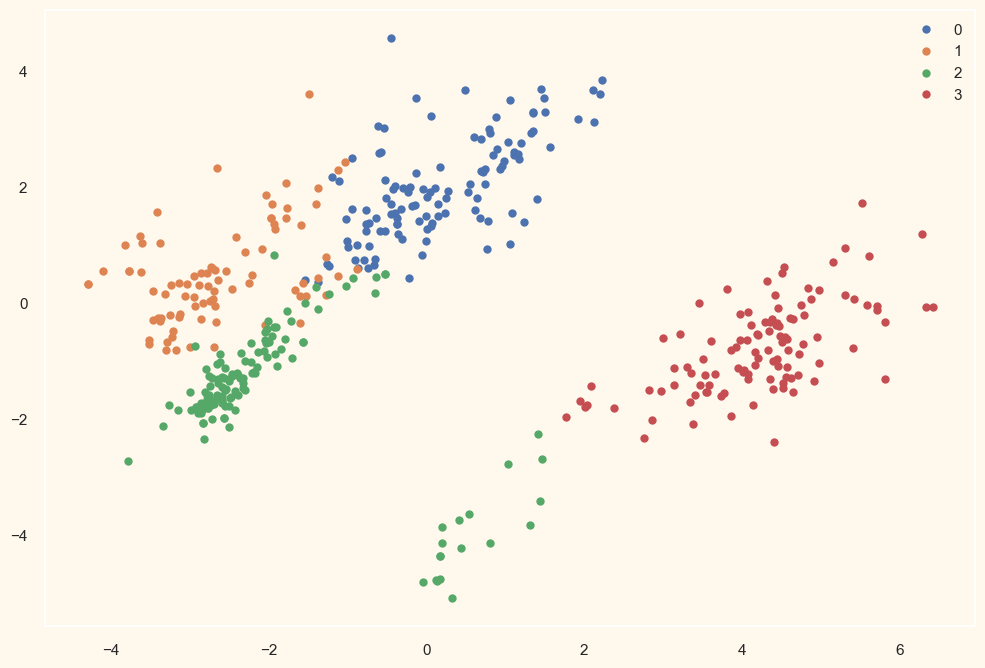

In [105]:
data_lda=modelLDA.transform(X_test)
plt.figure(figsize=(12,8))
classes = np.unique(scaled_ds_lda.Clusters)
for s in classes:
    class_data = data_lda[y_test==s]
    plt.plot(class_data[:,0],class_data[:,1],'o')
plt.grid()
plt.legend(classes)
plt.show()

### 8.4 QDA

#### 8.4.1 Original dataset

In [106]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA

ds = dataset.copy()


X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)


modelQDA = QDA()
modelQDA.fit(X_train,y_train)

predictedQDA = modelQDA.predict(X_test)
acc = accuracy_score(y_test, predictedQDA)
cm = confusion_matrix(y_test, predictedQDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedQDA,zero_division=0))

[[116   0   0   0]
 [ 81   4   0   0]
 [114   0   4  14]
 [  0   0   1 107]]
Accuracy: 0.52
              precision    recall  f1-score   support

           0       0.37      1.00      0.54       116
           1       1.00      0.05      0.09        85
           2       0.80      0.03      0.06       132
           3       0.88      0.99      0.93       108

    accuracy                           0.52       441
   macro avg       0.76      0.52      0.41       441
weighted avg       0.75      0.52      0.41       441



#### 8.4.2 PCA Original dataset

In [107]:
X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)


modelQDA = QDA()
modelQDA.fit(X_train,y_train)

predictedQDA = modelQDA.predict(X_test)
acc = accuracy_score(y_test, predictedQDA)
cm = confusion_matrix(y_test, predictedQDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedQDA,zero_division=0))

[[ 97   4   1  14]
 [  5  56  24   0]
 [  5  15 112   0]
 [ 33   3   0  72]]
Accuracy: 0.76
              precision    recall  f1-score   support

           0       0.69      0.84      0.76       116
           1       0.72      0.66      0.69        85
           2       0.82      0.85      0.83       132
           3       0.84      0.67      0.74       108

    accuracy                           0.76       441
   macro avg       0.77      0.75      0.75       441
weighted avg       0.77      0.76      0.76       441



#### 8.4.3 LDA Original dataset

In [108]:
X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)


modelQDA = QDA()
modelQDA.fit(X_train,y_train)

predictedQDA = modelQDA.predict(X_test)
acc = accuracy_score(y_test, predictedQDA)
cm = confusion_matrix(y_test, predictedQDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedQDA,zero_division=0))

[[113   2   1   0]
 [  1  82   2   0]
 [  6   4 122   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.94      0.97      0.96       116
           1       0.93      0.96      0.95        85
           2       0.98      0.92      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.97      0.96       441
weighted avg       0.96      0.96      0.96       441



#### 8.4.4 Scaled dataset

In [109]:
ds_scaled = scaled_ds.copy()
#to_drop = ["Income"]
#ds_scaled = ds_scaled.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)



modelQDA = QDA()
modelQDA.fit(X_train,y_train)

predictedQDA = modelQDA.predict(X_test)
acc = accuracy_score(y_test, predictedQDA)
cm = confusion_matrix(y_test, predictedQDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedQDA,zero_division=0))

[[111   5   0   0]
 [  1  84   0   0]
 [  9 105   0  18]
 [  0   0   0 108]]
Accuracy: 0.69
              precision    recall  f1-score   support

           0       0.92      0.96      0.94       116
           1       0.43      0.99      0.60        85
           2       0.00      0.00      0.00       132
           3       0.86      1.00      0.92       108

    accuracy                           0.69       441
   macro avg       0.55      0.74      0.62       441
weighted avg       0.53      0.69      0.59       441



#### 8.4.5 PCA Scaled dataset

In [110]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)


modelQDA = QDA()
modelQDA.fit(X_train,y_train)

predictedQDA = modelQDA.predict(X_test)
acc = accuracy_score(y_test, predictedQDA)
cm = confusion_matrix(y_test, predictedQDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedQDA,zero_division=0))

[[113   3   0   0]
 [  4  78   3   0]
 [  0   0 132   0]
 [  0   0   0 108]]
Accuracy: 0.98
              precision    recall  f1-score   support

           0       0.97      0.97      0.97       116
           1       0.96      0.92      0.94        85
           2       0.98      1.00      0.99       132
           3       1.00      1.00      1.00       108

    accuracy                           0.98       441
   macro avg       0.98      0.97      0.97       441
weighted avg       0.98      0.98      0.98       441



#### 8.4.6 LDA Scaled dataset


In [111]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_lda.Clusters,test_size=0.2, random_state=42)


modelQDA = QDA()
modelQDA.fit(X_train,y_train)

predictedQDA = modelQDA.predict(X_test)
acc = accuracy_score(y_test, predictedQDA)
cm = confusion_matrix(y_test, predictedQDA)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedQDA,zero_division=0))

[[113   2   1   0]
 [  1  82   2   0]
 [  6   4 122   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.94      0.97      0.96       116
           1       0.93      0.96      0.95        85
           2       0.98      0.92      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.97      0.96       441
weighted avg       0.96      0.96      0.96       441



Il miglior risultato per il classificatore QDA si ottiene con il dataset scalato e ridotto con PCA.

### 8.5 SVM

Questo modello di classificazione lavora bene con dati separabili linearmente nel caso di kernel lineari, dato che costruisce un piano separatore che massimizzi il margine tra le classi prese in esame.
In questa metodologia vi sono diversi kernel da usare per una separabilità noon lineare. Quello che viene fatto da un kernel è una trasformazione dei dati in più dimensioni, dove le dimensioni aggiuntive derivano dal kernel scelto  (quello che viene fatto in realtà è una trasformazione diretta sulla funzione di decisione e sul calcolo delle relazioni tra i singoli datapoints per ottimizzare il calcolo e non calcolare la trasformazione).

Un altra nota importante da tenere conto è che le SVM nella loro formulazione principale sono estremamente sensibili agli outlier , per evitare di overfittare e di tenere conto di singoli outlier che rovinerebbero il modello, vengono utilizzati dei regolarizzatori (coefficenti di penalità) utilizzati per implementare nelle SVM il cosidetto soft-margin, che permette a dei record di essere classificato in modo errato per diminuire il bias e rendere il modello costruito più flessibile. La ricerca dei parametri di penalizzazione viene attuata tramite cross-validation e ricerca di parametri ottimali (tramite grid-search).

Di seguito si vedranno vari risultati con vari kernel e parametri per infine sfociare nella ricerca dei parametri ottimali tramite GridSearch.

#### 8.5.1 Scaled dataset - PCA - LDA

SVM lavora meglio con i dati scalati

In [112]:
from sklearn.svm import SVC

ds_scaled = scaled_ds.copy()
#to_drop = ["Customer_For","Is_Parent","Children","Income","Age","Family_Size"]
#ds_scaled = ds_scaled.drop(to_drop, axis=1)


X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)



#X_train, X_test, y_train, y_test = train_test_split(PCA_ds, PCA_ds.Clusters,test_size=0.2, random_state=42)

#Parametro di regolarizzazione/penalizzazione relativamente basso dato che non c'è molto pericolo di overfitting dato l'inseparabilità dei dati
#in questo modo si ottiene un soft margin
modelsvm = SVC(kernel='linear')
modelsvm.fit(X_train,y_train)

predictedSVM = modelsvm.predict(X_test)
acc = accuracy_score(y_test, predictedSVM)
cm = confusion_matrix(y_test, predictedSVM)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedSVM,zero_division=0))

[[116   0   0   0]
 [  0  85   0   0]
 [  3   2 127   0]
 [  0   0   0 108]]
Accuracy: 0.99
              precision    recall  f1-score   support

           0       0.97      1.00      0.99       116
           1       0.98      1.00      0.99        85
           2       1.00      0.96      0.98       132
           3       1.00      1.00      1.00       108

    accuracy                           0.99       441
   macro avg       0.99      0.99      0.99       441
weighted avg       0.99      0.99      0.99       441



In [113]:
modelsvmrad = SVC(kernel='rbf')
modelsvmrad.fit(X_train,y_train)

predictedSVMrad = modelsvmrad.predict(X_test)
acc = accuracy_score(y_test, predictedSVMrad)
cm = confusion_matrix(y_test, predictedSVMrad)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedSVMrad,zero_division=0))

[[112   2   2   0]
 [  0  82   3   0]
 [  1   3 128   0]
 [  0   0   0 108]]
Accuracy: 0.98
              precision    recall  f1-score   support

           0       0.99      0.97      0.98       116
           1       0.94      0.96      0.95        85
           2       0.96      0.97      0.97       132
           3       1.00      1.00      1.00       108

    accuracy                           0.98       441
   macro avg       0.97      0.97      0.97       441
weighted avg       0.98      0.98      0.98       441



In [114]:
modelsvmpoly = SVC(kernel='poly')
modelsvmpoly.fit(X_train,y_train)

predictedSVMpoly = modelsvmpoly.predict(X_test)
acc = accuracy_score(y_test, predictedSVMpoly)
cm = confusion_matrix(y_test, predictedSVMpoly)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedSVMpoly,zero_division=0))

[[115   0   1   0]
 [  8  75   2   0]
 [  7   2 122   1]
 [  0   0   0 108]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.88      0.99      0.93       116
           1       0.97      0.88      0.93        85
           2       0.98      0.92      0.95       132
           3       0.99      1.00      1.00       108

    accuracy                           0.95       441
   macro avg       0.96      0.95      0.95       441
weighted avg       0.96      0.95      0.95       441



In [115]:
modelsvmpoly = SVC(kernel='sigmoid')
modelsvmpoly.fit(X_train,y_train)

predictedSVMpoly = modelsvmpoly.predict(X_test)
acc = accuracy_score(y_test, predictedSVMpoly)
cm = confusion_matrix(y_test, predictedSVMpoly)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedSVMpoly,zero_division=0))

[[110   3   0   3]
 [  0  83   2   0]
 [  0   2 130   0]
 [  6   0   1 101]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.95      0.95      0.95       116
           1       0.94      0.98      0.96        85
           2       0.98      0.98      0.98       132
           3       0.97      0.94      0.95       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



In [116]:
from sklearn.model_selection import GridSearchCV
param_grid = [
  {'C': [1, 10, 100], 'kernel': ['linear']}, #parametri da utilizzare con kernel lineare
  {'C': [1, 10, 90, 100], 'gamma': [0.01, 0.05, 0.001], 'kernel': ['rbf']}, #parametri da utilizzare con kernel radiale
  {'C': [1, 10, 100],'degree':[2,3,4,5] ,'gamma': [0.01, 0.05, 0.001], 'kernel': ['poly']}, #parametri da utilizzare con kernel polinomiale
  {'C': [1, 10, 100], 'kernel': ['sigmoid']}  
 ]
#definiamo l'oggetto Grid Search
#Passando l'argomento verbose, possiamo ottenere informazioni aggiuntive
#n_jobs permette di effettuare più test in parallelo

modelSVMgrid = GridSearchCV(SVC(), param_grid, verbose=1,n_jobs=4, cv=kf)

modelSVMgrid.fit(X_train,y_train)

Fitting 10 folds for each of 54 candidates, totalling 540 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=SVC(), n_jobs=4,
             param_grid=[{'C': [1, 10, 100], 'kernel': ['linear']},
                         {'C': [1, 10, 90, 100], 'gamma': [0.01, 0.05, 0.001],
                          'kernel': ['rbf']},
                         {'C': [1, 10, 100], 'degree': [2, 3, 4, 5],
                          'gamma': [0.01, 0.05, 0.001], 'kernel': ['poly']},
                         {'C': [1, 10, 100], 'kernel': ['sigmoid']}],
             verbose=1)

In [117]:
modelSVMgrid.score(X_test,y_test)

0.981859410430839

In [118]:
bestSVM = modelSVMgrid.best_estimator_
print(bestSVM)

bestSVM.fit(X_train,y_train)

bestpredicted = bestSVM.predict(X_test)
acc = accuracy_score(y_test, bestpredicted)
cm = confusion_matrix(y_test, bestpredicted)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,bestpredicted,zero_division=0))

SVC(C=100, gamma=0.01)
[[115   1   0   0]
 [  0  85   0   0]
 [  4   3 125   0]
 [  0   0   0 108]]
Accuracy: 0.98
              precision    recall  f1-score   support

           0       0.97      0.99      0.98       116
           1       0.96      1.00      0.98        85
           2       1.00      0.95      0.97       132
           3       1.00      1.00      1.00       108

    accuracy                           0.98       441
   macro avg       0.98      0.98      0.98       441
weighted avg       0.98      0.98      0.98       441



Come mostrano i test sopra il miglior risultato si ottiene con un kernel di tipo lineare.

### 8.6 Tree

Un modello di classificazione con alberi decisionali consiste nella costruzione di un albero, dove ogni nodo interno dell’albero contiene un test su un attributo che stabilisce quale sottoalbero deve essere visitato. Un test tipicamente valuta una feature (booleana, numerica, ecc.) o combinazioni di feature. Un percorso di classificazione è una concatenazione di regole IF-THEN sugli attributi. Ogni foglia rappresenta la classificazione ad una etichetta di classe.

La costruzione di un albero può avvenire con due strategie, una top-down ed una bottom-up, controllando le etichette di classe del training set e creando o foglie o nodi decisionali su un attributo scelto secondo delle scelte di purezza di un nodo(quante t-uple contiene con la stessa etichetta da classificare).

La creazione dei nodi e delle regole decisionali avviene in base al tipo di attributo selezionato per lo splitting e alle caratteristiche della feature coinvolta (per dati continui si sceglie una soglia secondo certe regole, per dati categoriali si dividono per classi di appartenenza).

La costruzione dell'albero decisionale dipende pesantemente sull'ordine delle feature scelte durante la classificazione e sul criterio utilizzato per sceglierle (solitamente viene scelto un criterio di purezza secondo delle misure di goodness come information gain, gain ratio o gini impurity).

L'albero ottenuto influisce pesantemente sulle prestazioni, quindi molti algoritmi utilizzano strategie complesse per la costruzione di un albero, come ad esempio strategie di boosting, cross-validation, ricerca di parametri ottimali, ibride e pruning.

Quello che viene utilizzato nella libreria di scikit learn ed in python in generale implementano quasi tutte le strategie sopra esposte, anche se non è possibile effettuare delle strategie di pruning in modo semplice. Un modo simulare queste strategie di pruning ed evitare overfitting e calo di prestazioni è ricorrere alle random forest, che verranno utilizzate nell'ultima parte di questa classificazione con alberi decisionali.

Uno dei vantaggi degli alberi decisionali è la loro interpretabilità. Un albero decisionale costruisce una serie di regole che vengono applicate in maniera gerarchica per ottenere un risultato finale.

#### 8.6.1 dataset original

In [119]:
from sklearn import tree 

ds = dataset.copy()
to_drop = ["Customer_For","Children","Is_Parent","Education","Income","Age","NumTotalPurchases",]
ds = ds.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelTree = tree.DecisionTreeClassifier(max_depth=12)
modelTree.fit(X_train,y_train)

predictedTree = modelTree.predict(X_test)
acc = accuracy_score(y_test, predictedTree)
cm = confusion_matrix(y_test, predictedTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedTree,zero_division=0))

[[89  2 10 15]
 [ 1 70 13  1]
 [ 4 27 95  6]
 [19  0  4 85]]
Accuracy: 0.77
              precision    recall  f1-score   support

           0       0.79      0.77      0.78       116
           1       0.71      0.82      0.76        85
           2       0.78      0.72      0.75       132
           3       0.79      0.79      0.79       108

    accuracy                           0.77       441
   macro avg       0.77      0.77      0.77       441
weighted avg       0.77      0.77      0.77       441



#### 8.6.2 PCA dataset original

In [120]:
X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelTree = tree.DecisionTreeClassifier(max_depth=12)
modelTree.fit(X_train,y_train)

predictedTree = modelTree.predict(X_test)
acc = accuracy_score(y_test, predictedTree)
cm = confusion_matrix(y_test, predictedTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedTree,zero_division=0))

[[ 84   6   4  22]
 [  6  56  23   0]
 [  4  23 105   0]
 [ 32   0   0  76]]
Accuracy: 0.73
              precision    recall  f1-score   support

           0       0.67      0.72      0.69       116
           1       0.66      0.66      0.66        85
           2       0.80      0.80      0.80       132
           3       0.78      0.70      0.74       108

    accuracy                           0.73       441
   macro avg       0.72      0.72      0.72       441
weighted avg       0.73      0.73      0.73       441



#### 8.6.3 LDA dataset original

In [121]:
X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelTree = tree.DecisionTreeClassifier(max_depth=12)
modelTree.fit(X_train,y_train)

predictedTree = modelTree.predict(X_test)
acc = accuracy_score(y_test, predictedTree)
cm = confusion_matrix(y_test, predictedTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedTree,zero_division=0))

[[112   2   2   0]
 [  2  81   2   0]
 [  5   4 123   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.94      0.97      0.95       116
           1       0.93      0.95      0.94        85
           2       0.97      0.93      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



#### 8.6.4 Scaled dataset

In [122]:
ds_scaled = scaled_ds.copy()
#to_drop = ["Customer_For","Is_Parent","Children","Income","Age","NumTotalPurchases","AmountSpent"]
#ds_scaled = ds_scaled.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelTree = tree.DecisionTreeClassifier(max_depth=12)
modelTree.fit(X_train,y_train)

predictedTree = modelTree.predict(X_test)
acc = accuracy_score(y_test, predictedTree)
cm = confusion_matrix(y_test, predictedTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedTree,zero_division=0))

[[111   2   3   0]
 [  5  77   3   0]
 [  5   2 125   0]
 [  0   0   3 105]]
Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.92      0.96      0.94       116
           1       0.95      0.91      0.93        85
           2       0.93      0.95      0.94       132
           3       1.00      0.97      0.99       108

    accuracy                           0.95       441
   macro avg       0.95      0.95      0.95       441
weighted avg       0.95      0.95      0.95       441



#### 8.6.5 PCA Scaled dataset

In [123]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelTree = tree.DecisionTreeClassifier(max_depth=12)
modelTree.fit(X_train,y_train)

predictedTree = modelTree.predict(X_test)
acc = accuracy_score(y_test, predictedTree)
cm = confusion_matrix(y_test, predictedTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedTree,zero_division=0))

[[115   1   0   0]
 [  2  83   0   0]
 [  0   1 131   0]
 [  0   0   0 108]]
Accuracy: 0.99
              precision    recall  f1-score   support

           0       0.98      0.99      0.99       116
           1       0.98      0.98      0.98        85
           2       1.00      0.99      1.00       132
           3       1.00      1.00      1.00       108

    accuracy                           0.99       441
   macro avg       0.99      0.99      0.99       441
weighted avg       0.99      0.99      0.99       441



#### 8.6.6 LDA Scaled dataset

In [124]:
X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_lda.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelTree = tree.DecisionTreeClassifier(max_depth=12)
modelTree.fit(X_train,y_train)

predictedTree = modelTree.predict(X_test)
acc = accuracy_score(y_test, predictedTree)
cm = confusion_matrix(y_test, predictedTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedTree,zero_division=0))

[[110   4   2   0]
 [  0  82   3   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.96      0.95      0.95       116
           1       0.92      0.96      0.94        85
           2       0.96      0.94      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



In [125]:
texttree=tree.export_text(modelTree,feature_names=list(LDA_ds.drop(["Clusters"],axis=1).columns))
print(texttree)

|--- col1 <= 2.11
|   |--- col2 <= 0.48
|   |   |--- col1 <= -1.10
|   |   |   |--- col3 <= 0.93
|   |   |   |   |--- col1 <= -1.56
|   |   |   |   |   |--- col3 <= -0.89
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- col3 >  -0.89
|   |   |   |   |   |   |--- col3 <= -0.54
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- col3 >  -0.54
|   |   |   |   |   |   |   |--- col3 <= 0.82
|   |   |   |   |   |   |   |   |--- col2 <= 0.40
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- col2 >  0.40
|   |   |   |   |   |   |   |   |   |--- col2 <= 0.42
|   |   |   |   |   |   |   |   |   |   |--- class: 2
|   |   |   |   |   |   |   |   |   |--- col2 >  0.42
|   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- col3 >  0.82
|   |   |   |   |   |   |   |   |--- col3 <= 0.86
|   |   |   |   |   |   |   |   |   |--- class: 2
|   |   |   |   |   |   |   |   |--- col3 >  0.86
|   |   |   |   

Il miglior risultato si ottiene con un dataset scalato e ridotto tramite PCA.

### 8.7 Random Forest

Il Random Forest è un esempio di modello (classificatore o predittore) ensemble che combina i risultati di diversi alberi decisionali mediante la tecnica bootstrap. In più il Random Forest addestra ciascun albero decisionale su un sottinsieme random di **m** attributi (bagging sugli attributi).

Alla fine del processo di costruzione dei vari classificatori(creati tramite training con dati e feature prese tramite bagging), si utilizza un modello ensemble per avere il risultato finale.

#### 8.7.1 dataset original

In [126]:
from sklearn.ensemble import RandomForestClassifier
#si sceglie un seme per avere gli stessi risultati, dato che random forest utilizza metodi randomici per costruire il modello
np.random.seed(777)

ds = dataset.copy()
to_drop = ["AmountSpent"]
ds = ds.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelRF = RandomForestClassifier(max_depth=10, n_estimators=1000)
modelRF.fit(X_train,y_train)

predictedRTree = modelRF.predict(X_test)
acc = accuracy_score(y_test, predictedRTree)
cm = confusion_matrix(y_test, predictedRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedRTree,zero_division=0))

[[112   1   3   0]
 [  2  80   3   0]
 [  4   1 127   0]
 [  0   0   0 108]]
Accuracy: 0.97
              precision    recall  f1-score   support

           0       0.95      0.97      0.96       116
           1       0.98      0.94      0.96        85
           2       0.95      0.96      0.96       132
           3       1.00      1.00      1.00       108

    accuracy                           0.97       441
   macro avg       0.97      0.97      0.97       441
weighted avg       0.97      0.97      0.97       441



#### 8.7.2 PCA dataset 

In [127]:
from sklearn.ensemble import RandomForestClassifier
#si sceglie un seme per avere gli stessi risultati, dato che random forest utilizza metodi randomici per costruire il modello
np.random.seed(777)

X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelRF = RandomForestClassifier(max_depth=10, n_estimators=1000)
modelRF.fit(X_train,y_train)

predictedRTree = modelRF.predict(X_test)
acc = accuracy_score(y_test, predictedRTree)
cm = confusion_matrix(y_test, predictedRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedRTree,zero_division=0))

[[ 92   6   3  15]
 [  5  63  17   0]
 [  4  21 107   0]
 [ 30   1   0  77]]
Accuracy: 0.77
              precision    recall  f1-score   support

           0       0.70      0.79      0.74       116
           1       0.69      0.74      0.72        85
           2       0.84      0.81      0.83       132
           3       0.84      0.71      0.77       108

    accuracy                           0.77       441
   macro avg       0.77      0.76      0.76       441
weighted avg       0.78      0.77      0.77       441



#### 8.7.3 LDA dataset 

In [128]:
from sklearn.ensemble import RandomForestClassifier
#si sceglie un seme per avere gli stessi risultati, dato che random forest utilizza metodi randomici per costruire il modello
np.random.seed(777)

X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelRF = RandomForestClassifier(max_depth=10, n_estimators=1000)
modelRF.fit(X_train,y_train)

predictedRTree = modelRF.predict(X_test)
acc = accuracy_score(y_test, predictedRTree)
cm = confusion_matrix(y_test, predictedRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedRTree,zero_division=0))

[[112   2   2   0]
 [  0  84   1   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.97
              precision    recall  f1-score   support

           0       0.96      0.97      0.96       116
           1       0.94      0.99      0.97        85
           2       0.98      0.94      0.96       132
           3       1.00      1.00      1.00       108

    accuracy                           0.97       441
   macro avg       0.97      0.97      0.97       441
weighted avg       0.97      0.97      0.97       441



### 8.7.4 Scaled dataset

In [129]:
from sklearn.ensemble import RandomForestClassifier
#si sceglie un seme per avere gli stessi risultati, dato che random forest utilizza metodi randomici per costruire il modello
np.random.seed(777)

ds_scaled = scaled_ds.copy()
to_drop = ["AmountSpent"]
ds_scaled = ds_scaled.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelRF = RandomForestClassifier(max_depth=10, n_estimators=1000)
modelRF.fit(X_train,y_train)

predictedRTree = modelRF.predict(X_test)
acc = accuracy_score(y_test, predictedRTree)
cm = confusion_matrix(y_test, predictedRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedRTree,zero_division=0))

[[112   1   3   0]
 [  2  80   3   0]
 [  4   1 127   0]
 [  0   0   0 108]]
Accuracy: 0.97
              precision    recall  f1-score   support

           0       0.95      0.97      0.96       116
           1       0.98      0.94      0.96        85
           2       0.95      0.96      0.96       132
           3       1.00      1.00      1.00       108

    accuracy                           0.97       441
   macro avg       0.97      0.97      0.97       441
weighted avg       0.97      0.97      0.97       441



#### 8.7.5 PCA Scaled dataset

In [130]:
from sklearn.ensemble import RandomForestClassifier
#si sceglie un seme per avere gli stessi risultati, dato che random forest utilizza metodi randomici per costruire il modello
np.random.seed(777)

X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelRF = RandomForestClassifier(max_depth=10, n_estimators=1000)
modelRF.fit(X_train,y_train)

predictedRTree = modelRF.predict(X_test)
acc = accuracy_score(y_test, predictedRTree)
cm = confusion_matrix(y_test, predictedRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedRTree,zero_division=0))

[[115   1   0   0]
 [  3  82   0   0]
 [  0   0 132   0]
 [  0   0   0 108]]
Accuracy: 0.99
              precision    recall  f1-score   support

           0       0.97      0.99      0.98       116
           1       0.99      0.96      0.98        85
           2       1.00      1.00      1.00       132
           3       1.00      1.00      1.00       108

    accuracy                           0.99       441
   macro avg       0.99      0.99      0.99       441
weighted avg       0.99      0.99      0.99       441



#### 8.7.6 LDA Scaled dataset

In [131]:
from sklearn.ensemble import RandomForestClassifier
#si sceglie un seme per avere gli stessi risultati, dato che random forest utilizza metodi randomici per costruire il modello
np.random.seed(777)

X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_lda.Clusters,test_size=0.2, random_state=42)

#limitiamo la profondità massima dell'albero per poterlo visualizzare in seguito
modelRF = RandomForestClassifier(max_depth=10, n_estimators=1000)
modelRF.fit(X_train,y_train)

predictedRTree = modelRF.predict(X_test)
acc = accuracy_score(y_test, predictedRTree)
cm = confusion_matrix(y_test, predictedRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedRTree,zero_division=0))

[[112   2   2   0]
 [  0  84   1   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.97
              precision    recall  f1-score   support

           0       0.96      0.97      0.96       116
           1       0.94      0.99      0.97        85
           2       0.98      0.94      0.96       132
           3       1.00      1.00      1.00       108

    accuracy                           0.97       441
   macro avg       0.97      0.97      0.97       441
weighted avg       0.97      0.97      0.97       441



In [133]:
texttree=tree.export_text(modelRF.estimators_[0],feature_names=list(scaled_ds_lda.drop(["Clusters"],axis=1).columns))
print(texttree)

|--- col1 <= 1.86
|   |--- col3 <= -1.04
|   |   |--- col3 <= -1.42
|   |   |   |--- col2 <= -2.80
|   |   |   |   |--- col1 <= -1.51
|   |   |   |   |   |--- class: 1.0
|   |   |   |   |--- col1 >  -1.51
|   |   |   |   |   |--- class: 0.0
|   |   |   |--- col2 >  -2.80
|   |   |   |   |--- col1 <= -1.00
|   |   |   |   |   |--- class: 1.0
|   |   |   |   |--- col1 >  -1.00
|   |   |   |   |   |--- col2 <= -2.49
|   |   |   |   |   |   |--- class: 0.0
|   |   |   |   |   |--- col2 >  -2.49
|   |   |   |   |   |   |--- col2 <= -2.24
|   |   |   |   |   |   |   |--- class: 1.0
|   |   |   |   |   |   |--- col2 >  -2.24
|   |   |   |   |   |   |   |--- class: 0.0
|   |   |--- col3 >  -1.42
|   |   |   |--- col1 <= -1.52
|   |   |   |   |--- col2 <= 0.96
|   |   |   |   |   |--- class: 1.0
|   |   |   |   |--- col2 >  0.96
|   |   |   |   |   |--- class: 2.0
|   |   |   |--- col1 >  -1.52
|   |   |   |   |--- col2 <= 0.35
|   |   |   |   |   |--- col1 <= -1.30
|   |   |   |   |   |   |---

In [134]:
#definiamo la griglia di parametri
param_grid = {'max_depth': [5, 10, 15, None], 'n_estimators': [50, 100, 150, 200]}
#definiamo l'oggetto Grid Search
bestRF = GridSearchCV(RandomForestClassifier(), param_grid, verbose=1, n_jobs=4, cv=kf)
#avviamo la ricerca dei parametri ottimali sui nostri dati
bestRF.fit(X_train,y_train)

Fitting 10 folds for each of 16 candidates, totalling 160 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(), n_jobs=4,
             param_grid={'max_depth': [5, 10, 15, None],
                         'n_estimators': [50, 100, 150, 200]},
             verbose=1)

In [135]:
bestRF = bestRF.best_estimator_
predictedbestRTree = bestRF.predict(X_test)
acc = accuracy_score(y_test, predictedbestRTree)
cm = confusion_matrix(y_test, predictedbestRTree)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedbestRTree,zero_division=0))

[[113   1   2   0]
 [  0  84   1   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.97
              precision    recall  f1-score   support

           0       0.96      0.97      0.97       116
           1       0.95      0.99      0.97        85
           2       0.98      0.94      0.96       132
           3       1.00      1.00      1.00       108

    accuracy                           0.97       441
   macro avg       0.97      0.98      0.97       441
weighted avg       0.97      0.97      0.97       441



### 8.8 K-NN

Il classificatore K-nearest neighbors è un tipo di classificatore che utilizza la vicinanza spaziale (o la similarità per spazi non euclidei) che utilizza delle tecniche di apprendimento lazy (apprendimento e costruzione del modello veloce, ma predizine più dispendiosa) per la costruzione del modello e le predizioni di etichetta.

Il modello di classificatore K-nn funziona nel seguente modo:

Fissato k, si prendono le k tuple più vicine alla tupla X da classificare.
Si assegnano a X la classe più ricorrente (etichetta di maggioranza) tra le classi delle k tuple scelte.

La vicinanza di un record rispetto ad altri viene implementata o tramite distanza (euclidea o altro), oppure come similarità tra oggetti.

Un possibile modello 1-nn si può costruire nel seguente modo.

#### 8.8.1 Original Dataset

In [136]:
from sklearn.neighbors import KNeighborsClassifier

ds = dataset.copy()
to_drop = ["Customer_For","Children","Is_Parent","Education"]
ds = ds.drop(to_drop, axis=1)


X_train, X_test, y_train, y_test = train_test_split(ds.drop(["Clusters"],axis=1), ds.Clusters,test_size=0.2, random_state=42)

model1NN = KNeighborsClassifier(n_neighbors=1)
model1NN.fit(X_train,y_train)

predicted1NN = model1NN.predict(X_test)
acc = accuracy_score(y_test, predicted1NN)
cm = confusion_matrix(y_test, predicted1NN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predicted1NN,zero_division=0))

[[73  7 10 26]
 [ 7 51 26  1]
 [ 3 35 92  2]
 [33  1  3 71]]
Accuracy: 0.65
              precision    recall  f1-score   support

           0       0.63      0.63      0.63       116
           1       0.54      0.60      0.57        85
           2       0.70      0.70      0.70       132
           3       0.71      0.66      0.68       108

    accuracy                           0.65       441
   macro avg       0.65      0.65      0.65       441
weighted avg       0.65      0.65      0.65       441



#### 8.8.2 PCA dataset

In [137]:
from sklearn.neighbors import KNeighborsClassifier

X_train, X_test, y_train, y_test = train_test_split(PCA_ds.drop(["Clusters"],axis=1), PCA_ds.Clusters,test_size=0.2, random_state=42)

model1NN = KNeighborsClassifier(n_neighbors=1)
model1NN.fit(X_train,y_train)

predicted1NN = model1NN.predict(X_test)
acc = accuracy_score(y_test, predicted1NN)
cm = confusion_matrix(y_test, predicted1NN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predicted1NN,zero_division=0))

[[51 18 19 28]
 [19 31 25 10]
 [39 24 54 15]
 [34 18 13 43]]
Accuracy: 0.41
              precision    recall  f1-score   support

           0       0.36      0.44      0.39       116
           1       0.34      0.36      0.35        85
           2       0.49      0.41      0.44       132
           3       0.45      0.40      0.42       108

    accuracy                           0.41       441
   macro avg       0.41      0.40      0.40       441
weighted avg       0.41      0.41      0.41       441



### 8.8.3 LDA Dataset

In [138]:
from sklearn.neighbors import KNeighborsClassifier


X_train, X_test, y_train, y_test = train_test_split(LDA_ds.drop(["Clusters"],axis=1), LDA_ds.Clusters,test_size=0.2, random_state=42)

model1NN = KNeighborsClassifier(n_neighbors=1)
model1NN.fit(X_train,y_train)

predicted1NN = model1NN.predict(X_test)
acc = accuracy_score(y_test, predicted1NN)
cm = confusion_matrix(y_test, predicted1NN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predicted1NN,zero_division=0))

[[111   3   2   0]
 [  1  81   3   0]
 [  4   3 125   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       116
           1       0.93      0.95      0.94        85
           2       0.96      0.95      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



#### 8.8.4 Scaled Dataset

In [139]:
from sklearn.neighbors import KNeighborsClassifier

ds_scaled = scaled_ds.copy()
to_drop = ["Customer_For","Children","Is_Parent"]
ds_scaled = ds_scaled.drop(to_drop, axis=1)

X_train, X_test, y_train, y_test = train_test_split(ds_scaled.drop(["Clusters"],axis=1), ds_scaled.Clusters,test_size=0.2, random_state=42)

model1NN = KNeighborsClassifier(n_neighbors=1)
model1NN.fit(X_train,y_train)

predicted1NN = model1NN.predict(X_test)
acc = accuracy_score(y_test, predicted1NN)
cm = confusion_matrix(y_test, predicted1NN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predicted1NN,zero_division=0))

[[ 94   7   2  13]
 [  4  73   7   1]
 [  4   7 119   2]
 [ 14   0   0  94]]
Accuracy: 0.86
              precision    recall  f1-score   support

           0       0.81      0.81      0.81       116
           1       0.84      0.86      0.85        85
           2       0.93      0.90      0.92       132
           3       0.85      0.87      0.86       108

    accuracy                           0.86       441
   macro avg       0.86      0.86      0.86       441
weighted avg       0.86      0.86      0.86       441



#### 8.8.5 PCA Scaled Dataset

In [140]:
from sklearn.neighbors import KNeighborsClassifier

X_train, X_test, y_train, y_test = train_test_split(scaled_ds_pca.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)

model1NN = KNeighborsClassifier(n_neighbors=1)
model1NN.fit(X_train,y_train)

predicted1NN = model1NN.predict(X_test)
acc = accuracy_score(y_test, predicted1NN)
cm = confusion_matrix(y_test, predicted1NN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predicted1NN,zero_division=0))

[[110   6   0   0]
 [  1  84   0   0]
 [  0   0 131   1]
 [  0   0   0 108]]
Accuracy: 0.98
              precision    recall  f1-score   support

           0       0.99      0.95      0.97       116
           1       0.93      0.99      0.96        85
           2       1.00      0.99      1.00       132
           3       0.99      1.00      1.00       108

    accuracy                           0.98       441
   macro avg       0.98      0.98      0.98       441
weighted avg       0.98      0.98      0.98       441



#### 8.8.6 LDA Scaled Dataset

In [141]:
from sklearn.neighbors import KNeighborsClassifier

X_train, X_test, y_train, y_test = train_test_split(scaled_ds_lda.drop(["Clusters"],axis=1), scaled_ds_pca.Clusters,test_size=0.2, random_state=42)

model1NN = KNeighborsClassifier(n_neighbors=1)
model1NN.fit(X_train,y_train)

predicted1NN = model1NN.predict(X_test)
acc = accuracy_score(y_test, predicted1NN)
cm = confusion_matrix(y_test, predicted1NN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predicted1NN,zero_division=0))

[[111   3   2   0]
 [  1  81   3   0]
 [  4   3 125   0]
 [  0   0   0 108]]
Accuracy: 0.96
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       116
           1       0.93      0.95      0.94        85
           2       0.96      0.95      0.95       132
           3       1.00      1.00      1.00       108

    accuracy                           0.96       441
   macro avg       0.96      0.96      0.96       441
weighted avg       0.96      0.96      0.96       441



In [142]:
param_grid = [ {'n_neighbors':range(1,40)}]

modelKNNbest = GridSearchCV(KNeighborsClassifier(), param_grid)
modelKNNbest.fit(X_train,y_train)
bestKNN = modelKNNbest.best_estimator_
print("Migliore valore di K trovato utilizzando solo il training set: %d" % bestKNN.n_neighbors)

Migliore valore di K trovato utilizzando solo il training set: 24


In [143]:
predictedBestKNN = bestKNN.predict(X_test)
acc = accuracy_score(y_test, predictedBestKNN)
cm = confusion_matrix(y_test, predictedBestKNN)
print(cm)
print("Accuracy: {:0.2f}".format(acc))
print(classification_report(y_test,predictedBestKNN,zero_division=0))

[[111   3   2   0]
 [  0  84   1   0]
 [  5   3 124   0]
 [  0   0   0 108]]
Accuracy: 0.97
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       116
           1       0.93      0.99      0.96        85
           2       0.98      0.94      0.96       132
           3       1.00      1.00      1.00       108

    accuracy                           0.97       441
   macro avg       0.97      0.97      0.97       441
weighted avg       0.97      0.97      0.97       441



### 9. Confronto dei modelli costruiti

In [144]:
scores = cross_val_score(modelLogit, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for Logit:", scores)
print('accuracy for Logit: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelNBgaussian, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for Naive Bayes Gaussian:", scores)
print('accuracy for Naive Bayes Gaussian: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelQDA, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for QDA:", scores)
print('accuracy for QDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelLDA, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for LDA:", scores)
print('accuracy for LDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelTree, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for decision tree:", scores)
print('accuracy for decision tree: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestRF, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for RandomForest:", scores)
print('accuracy for RandomForest: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestKNN, dataset.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for K-nearest neighbor:", scores)
print('accuracy for k-nearest neighbor: ',(np.mean(scores)),"(", (np.std(scores)),")")

Cross-validated scores for Logit: [0.25791855 0.22171946 0.24434389 0.32126697 0.26696833 0.23636364
 0.31818182 0.31818182 0.28181818 0.24545455]
accuracy for Logit:  0.27122171945701357 ( 0.03503470301778971 ) 

Cross-validated scores for Naive Bayes Gaussian: [0.28506787 0.39366516 0.36199095 0.32126697 0.31221719 0.30454545
 0.30454545 0.32272727 0.28636364 0.27727273]
accuracy for Naive Bayes Gaussian:  0.31696626902509256 ( 0.034383629429488874 ) 

Cross-validated scores for QDA: [0.59276018 0.55656109 0.49773756 0.49321267 0.42081448 0.55
 0.56818182 0.50454545 0.5        0.55454545]
accuracy for QDA:  0.5238358700123407 ( 0.04752713106174748 ) 

Cross-validated scores for LDA: [0.9638009  0.91855204 0.95022624 0.97285068 0.95022624 0.93181818
 0.91818182 0.92727273 0.95       0.91818182]
accuracy for LDA:  0.9401110654051831 ( 0.018962293767434087 ) 

Cross-validated scores for decision tree: [0.95475113 0.94570136 0.95927602 0.97285068 0.95927602 0.95
 0.97727273 0.97727273 0.

Sostanzialmente, i peggiori classificatori sono migliorati di poco, mentre la maggior parte dei migliori sono peggiorati di molto. Il dataset trovato quindi sembra inutilizzabile.

Si passa ora alla scomposizione tramite PCA vista precedentemente, quindi si costruisce il dataset trasformato per vedere come lavora con i classificatori.

In [145]:
scores = cross_val_score(modelLogit, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) Logit:", scores)
print('accuracy for Logit: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelNBgaussian, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) Naive Bayes Gaussian:", scores)
print('accuracy for Naive Bayes Gaussian: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelQDA, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) QDA:", scores)
print('accuracy for QDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelLDA, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) LDA:", scores)
print('accuracy for LDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelTree, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) decision tree:", scores)
print('accuracy for decision tree: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestRF, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) RandomForest:", scores)
print('accuracy for RandomForest: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestKNN, PCA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA) K-nearest neighbor:", scores)
print('accuracy for k-nearest neighbor: ',(np.mean(scores)),"(", (np.std(scores)),")")

Cross-validated scores for transformed data (PCA) Logit: [0.28054299 0.30769231 0.29411765 0.30316742 0.29864253 0.29545455
 0.28181818 0.31363636 0.30454545 0.28636364]
accuracy for Logit:  0.29659810777457835 ( 0.010546550457330085 ) 

Cross-validated scores for transformed data (PCA) Naive Bayes Gaussian: [0.33031674 0.35294118 0.30316742 0.30316742 0.24886878 0.30454545
 0.33181818 0.27727273 0.32272727 0.33181818]
accuracy for Naive Bayes Gaussian:  0.31066433566433566 ( 0.02880550608018765 ) 

Cross-validated scores for transformed data (PCA) QDA: [0.760181   0.77828054 0.76470588 0.7918552  0.75565611 0.69545455
 0.72727273 0.76818182 0.79545455 0.71363636]
accuracy for QDA:  0.7550678733031673 ( 0.03139659980676499 ) 

Cross-validated scores for transformed data (PCA) LDA: [0.78280543 0.75113122 0.75565611 0.70135747 0.70588235 0.73636364
 0.74090909 0.75       0.74090909 0.71818182]
accuracy for LDA:  0.7383196215549157 ( 0.02328358714382082 ) 

Cross-validated scores for tran

Infine con LDA


In [146]:
scores = cross_val_score(modelLogit,LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) Logit:", scores)
print('accuracy for Logit: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelNBgaussian, LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) Naive Bayes Gaussian:", scores)
print('accuracy for Naive Bayes Gaussian: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelQDA, LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) QDA:", scores)
print('accuracy for QDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelLDA, LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) LDA:", scores)
print('accuracy for LDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelTree, LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) decision tree:", scores)
print('accuracy for decision tree: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestRF, LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) RandomForest:", scores)
print('accuracy for RandomForest: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestKNN, LDA_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA) K-nearest neighbor:", scores)
print('accuracy for k-nearest neighbor: ',(np.mean(scores)),"(", (np.std(scores)),")")

Cross-validated scores for transformed data (LDA) Logit: [0.9638009  0.97285068 0.9638009  0.97737557 0.94570136 0.96818182
 0.96818182 0.99090909 0.99545455 0.95      ]
accuracy for Logit:  0.9696256684491977 ( 0.014900138323522282 ) 

Cross-validated scores for transformed data (LDA) Naive Bayes Gaussian: [0.94570136 0.9321267  0.96832579 0.93665158 0.94570136 0.94545455
 0.95909091 0.95909091 0.92272727 0.95909091]
accuracy for Naive Bayes Gaussian:  0.9473961332784862 ( 0.013472275090440343 ) 

Cross-validated scores for transformed data (LDA) QDA: [0.96832579 0.9638009  0.97285068 0.95927602 0.94570136 0.93636364
 0.95       0.98181818 0.95       0.95454545]
accuracy for QDA:  0.9582682023858494 ( 0.012993662073572141 ) 

Cross-validated scores for transformed data (LDA) LDA: [0.94117647 0.94117647 0.91402715 0.94570136 0.94570136 0.92272727
 0.95909091 0.95454545 0.92727273 0.94545455]
accuracy for LDA:  0.9396873714520773 ( 0.013444353568584025 ) 

Cross-validated scores for tra

#### scaled dataset

In [147]:
scores = cross_val_score(modelLogit,scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) Logit:", scores)
print('accuracy for Logit: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelNBgaussian, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) Naive Bayes Gaussian:", scores)
print('accuracy for Naive Bayes Gaussian: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelQDA, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) QDA:", scores)
print('accuracy for QDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelLDA, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) LDA:", scores)
print('accuracy for LDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestSVM, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) SVM:", scores)
print('accuracy for SVM: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelTree, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) decision tree:", scores)
print('accuracy for decision tree: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestRF, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) RandomForest:", scores)
print('accuracy for RandomForest: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestKNN, scaled_ds.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (scaled) K-nearest neighbor:", scores)
print('accuracy for k-nearest neighbor: ',(np.mean(scores)),"(", (np.std(scores)),")")

Cross-validated scores for transformed data (scaled) Logit: [0.98190045 0.99547511 0.99547511 0.98190045 0.98642534 0.98181818
 0.99545455 0.99090909 0.99090909 1.        ]
accuracy for Logit:  0.9900267379679144 ( 0.006342532806935135 ) 

Cross-validated scores for transformed data (scaled) Naive Bayes Gaussian: [0.72850679 0.75113122 0.76923077 0.760181   0.78280543 0.75454545
 0.73181818 0.74545455 0.77272727 0.75909091]
accuracy for Naive Bayes Gaussian:  0.7555491567256272 ( 0.016358643625319826 ) 

Cross-validated scores for transformed data (scaled) QDA: [0.72850679 0.69683258 0.66968326 0.71945701 0.67873303 0.72727273
 0.70909091 0.71818182 0.63636364 0.68636364]
accuracy for QDA:  0.6970485396955985 ( 0.02806792555951758 ) 

Cross-validated scores for transformed data (scaled) LDA: [0.94570136 0.92760181 0.94570136 0.9321267  0.91855204 0.93181818
 0.96363636 0.93636364 0.95909091 0.93636364]
accuracy for LDA:  0.9396955985191278 ( 0.013252669343513757 ) 

Cross-validated sco

#### pca scaled

In [148]:
scores = cross_val_score(modelLogit,scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) Logit:", scores)
print('accuracy for Logit: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelNBgaussian, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) Naive Bayes Gaussian:", scores)
print('accuracy for Naive Bayes Gaussian: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelQDA, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) QDA:", scores)
print('accuracy for QDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelLDA, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) LDA:", scores)
print('accuracy for LDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestSVM, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) SVM:", scores)
print('accuracy for SVM: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelTree, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) decision tree:", scores)
print('accuracy for decision tree: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestRF, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) RandomForest:", scores)
print('accuracy for RandomForest: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestKNN, scaled_ds_pca.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (PCA scaled) K-nearest neighbor:", scores)
print('accuracy for k-nearest neighbor: ',(np.mean(scores)),"(", (np.std(scores)),")")

Cross-validated scores for transformed data (PCA scaled) Logit: [0.98642534 0.99547511 0.99547511 0.99547511 1.         1.
 1.         0.99545455 1.         0.99090909]
accuracy for Logit:  0.9959214315096668 ( 0.00427380148002061 ) 

Cross-validated scores for transformed data (PCA scaled) Naive Bayes Gaussian: [0.98190045 0.98642534 1.         0.99095023 0.98642534 0.98181818
 0.99545455 1.         0.97727273 0.98636364]
accuracy for Naive Bayes Gaussian:  0.9886610448375155 ( 0.007389416852955632 ) 

Cross-validated scores for transformed data (PCA scaled) QDA: [0.97285068 0.99095023 0.98190045 0.97737557 0.98642534 0.98636364
 1.         0.99545455 0.98636364 0.99545455]
accuracy for QDA:  0.9873138626079804 ( 0.008040873300497289 ) 

Cross-validated scores for transformed data (PCA scaled) LDA: [0.97285068 0.99547511 0.99547511 0.98190045 0.99095023 0.98636364
 0.99090909 0.99090909 0.99545455 0.98636364]
accuracy for LDA:  0.9886651583710409 ( 0.006786691130791887 ) 

Cross-valid

#### lda scaled

In [149]:
scores = cross_val_score(modelLogit,scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) Logit:", scores)
print('accuracy for Logit: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelNBgaussian, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) Naive Bayes Gaussian:", scores)
print('accuracy for Naive Bayes Gaussian: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelQDA, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) QDA:", scores)
print('accuracy for QDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelLDA, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) LDA:", scores)
print('accuracy for LDA: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestSVM, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) SVM:", scores)
print('accuracy for SVM: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(modelTree, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) decision tree:", scores)
print('accuracy for decision tree: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestRF, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) RandomForest:", scores)
print('accuracy for RandomForest: ',(np.mean(scores)),"(", (np.std(scores)),")","\n")
scores = cross_val_score(bestKNN, scaled_ds_lda.drop(["Clusters"],axis=1), dataset.Clusters, cv=kf)
print ("Cross-validated scores for transformed data (LDA scaled) K-nearest neighbor:", scores)
print('accuracy for k-nearest neighbor: ',(np.mean(scores)),"(", (np.std(scores)),")")

Cross-validated scores for transformed data (LDA scaled) Logit: [0.96832579 0.96832579 0.95475113 0.9638009  0.95022624 0.96818182
 0.96363636 0.98636364 0.99090909 0.97727273]
accuracy for Logit:  0.969179350061703 ( 0.012093313714768811 ) 

Cross-validated scores for transformed data (LDA scaled) Naive Bayes Gaussian: [0.94570136 0.94117647 0.94117647 0.9321267  0.95022624 0.96818182
 0.93181818 0.96363636 0.95909091 0.92272727]
accuracy for Naive Bayes Gaussian:  0.9455861785273549 ( 0.014044320353428438 ) 

Cross-validated scores for transformed data (LDA scaled) QDA: [0.95475113 0.93665158 0.98642534 0.95475113 0.97285068 0.96363636
 0.95454545 0.95       0.95454545 0.95909091]
accuracy for QDA:  0.9587248046071576 ( 0.01273177434916069 ) 

Cross-validated scores for transformed data (LDA scaled) LDA: [0.93665158 0.9321267  0.94570136 0.9321267  0.9321267  0.94090909
 0.94090909 0.92272727 0.96818182 0.95454545]
accuracy for LDA:  0.9406005758946936 ( 0.01237684243584232 ) 

Cross

In [150]:
ds_scaled

,Education,Income,Age,AmountSpent,Family_Size,TotalAcceptedCmp,NumTotalPurchases,Clusters
0,0.943112,0.314651,1.017189,1.679323,-1.759012,0.614920,1.328161,3
1,0.943112,-0.254877,1.273530,-0.963897,0.448513,-0.503808,-1.167390,1
2,0.943112,0.965354,0.333612,0.281242,-0.655250,-0.503808,0.802782,3
3,0.943112,-1.206087,-1.289883,-0.920675,0.448513,-0.503808,-0.904700,2
4,-1.060320,0.322136,-1.033542,-0.307248,0.448513,-0.503808,0.540092,0
...,...,...,...,...,...,...,...,...
2200,0.943112,0.463624,0.162718,1.220500,0.448513,-0.503808,0.408747,0
2201,-1.060320,0.598401,1.957107,-0.270675,2.656038,0.614920,0.934126,1
2202,0.943112,0.258780,-1.033542,1.054260,-1.759012,0.614920,0.540092,3
2203,-1.060320,0.851004,1.102636,0.392623,0.448513,-0.503808,1.065471,0


In [151]:
ds_scaled = scaled_ds.copy()
last_row = ds_scaled.drop(ds_scaled.index[-2:-1])
last_row

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases,Clusters
0,0.943112,0.314651,1.974128,1.017189,1.679323,-1.266589,-1.759012,-1.58466,0.614920,1.328161,3
1,0.943112,-0.254877,-1.664957,1.273530,-0.963897,1.403420,0.448513,0.63105,-0.503808,-1.167390,1
2,0.943112,0.965354,-0.172330,0.333612,0.281242,-1.266589,-0.655250,-1.58466,-0.503808,0.802782,3
3,0.943112,-1.206087,-1.923048,-1.289883,-0.920675,0.068415,0.448513,0.63105,-0.503808,-0.904700,2
4,-1.060320,0.322136,-0.821859,-1.033542,-0.307248,0.068415,0.448513,0.63105,-0.503808,0.540092,0
...,...,...,...,...,...,...,...,...,...,...,...
2199,0.943112,-0.830635,0.799813,-0.435412,-0.958910,0.068415,0.448513,0.63105,-0.503808,-1.430080,2
2200,0.943112,0.463624,0.124475,0.162718,1.220500,0.068415,0.448513,0.63105,-0.503808,0.408747,0
2201,-1.060320,0.598401,-1.940254,1.957107,-0.270675,2.738424,2.656038,0.63105,0.614920,0.934126,1
2202,0.943112,0.258780,-0.847668,-1.033542,1.054260,-1.266589,-1.759012,-1.58466,0.614920,0.540092,3


In [152]:
last_row = scaled_ds.tail(2)

last_row = last_row.drop(last_row.index[-1:])

last_row

,Education,Income,Customer_For,Age,AmountSpent,Children,Family_Size,Is_Parent,TotalAcceptedCmp,NumTotalPurchases,Clusters
2203,-1.06032,0.851004,-0.843367,1.102636,0.392623,0.068415,0.448513,0.63105,-0.503808,1.065471,0


### Rete neurale 

Infine abbiamo una semplice rete neurale composta da 3 layer e la funzione d'attivazione softmax che creerà una distribuzione di probabilità in cui la classe più probabile otterrà un numero maggiore. Viene usata la CrossEntropyLoss e come algoritmo di ottimizzazione Adam (Adaptive Moment Estimation). Adam è una variante della discesa del gradiente che utilizza un tasso di apprendimento adattivo per ogni parametro del modello. Ciò significa che Adam può automaticamente regolare il tasso di apprendimento per ogni parametro in base alla sua performance durante l'allenamento. Inoltre, Adam tiene traccia di momenti del gradiente per ogni parametro, il che gli consente di adattarsi in modo più efficiente ai dati di allenamento rispetto alla discesa del gradiente.

In [153]:
import torch
import torch.nn as nn
import pandas as pd
from sklearn.model_selection import train_test_split
from torch.optim import SGD
from sklearn.metrics import classification_report

# Carica il tuo dataframe
#df = pd.read_csv("percorso/al/tuo/file.csv")


ds_scaled = scaled_ds.copy()
#to_drop = ["Customer_For","Children","Is_Parent","NumTotalPurchases"]
#ds_scaled = ds_scaled.drop(to_drop, axis=1)
ds_scaled = ds_scaled.drop(ds_scaled.index[-2:-1]) #elimino la 

X = ds_scaled.drop("Clusters", axis=1).values
y = ds_scaled["Clusters"].values


# Trasforma gli input e le etichette in tensori PyTorch
X = torch.tensor(X, dtype=torch.float32)
y = torch.tensor(y, dtype=torch.long)

# Dividi i dati in set di training e di validation
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)

# Verifica la presenza di CUDA
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



# Definici il modello della rete neurale
class Classificatore(nn.Module):
    def __init__(self, num_features, num_classes):
        super(Classificatore, self).__init__()
        self.fc1 = nn.Linear(num_features, 64)
        self.fc2 = nn.Linear(64, 64)
        self.fc3 = nn.Linear(64, num_classes)
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        return self.softmax(x)

# Inizializza il modello con il numero di features e di classi
model = Classificatore(num_features=X_train.shape[1], num_classes=len(np.unique(y_train)))

# Definisci la funzione di perdita e l'ottimizzatore
loss_fn = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model.parameters())
#optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.99)

# Definici il batch size
batch_size = 64

# Definisci una funzione per il training del modello
def train(model, loss_fn, optimizer, X_train, y_train, device, num_epochs=100):
    # Sposta il modello e i dati sulla GPU
    model = model.to(device)
    X_train = X_train.to(device)
    y_train = y_train.to(device)

    for epoch in range(num_epochs):
        # Mischia gli indici dei dati di training
        indices = torch.randperm(X_train.shape[0])

        # Dividi i dati in batches
        for i in range(0, X_train.shape[0], batch_size):
            # Seleziona i dati del batch corrente
            X_batch = X_train[indices[i:i+batch_size]]
            y_batch = y_train[indices[i:i+batch_size]]

            # Calcola le previsioni del modello sui dati del batch
            y_pred = model(X_batch)

            # Calcola la perdita sui dati del batch
            loss = loss_fn(y_pred, y_batch)

            # Azzera i gradienti
            optimizer.zero_grad()

            # Calcola i gradienti
            loss.backward()

            # Aggiorna i pesi del modello
            optimizer.step()

# Definisci una funzione per il test del modello
def test(model, X_val, y_val, device):
    # Sposta il modello e i dati sulla GPU
    model = model.to(device)
    X_val = X_val.to(device)
    y_val = y_val.to(device)

    # Calcola le previsioni del modello sui dati di validation
    y_pred = model(X_val)

    # Calcola l'accuratezza sui dati di validation
    accuracy = (y_pred.argmax(dim=1) == y_val).float().mean().item()
    
    # Attiva la modalità di valutazione
    model.eval()

    # Calcola le previsioni del modello sui dati di validazione
    with torch.no_grad():
        y_pred = model(X_val)

    # Trasforma le previsioni in formato numpy
    y_pred = y_pred.cpu().numpy()

    # Calcola il report di classificazione
    report = classification_report(y_val.cpu(), y_pred.argmax(axis=1))
    
    return accuracy, report

# Esegui il training del modello per un numero di epochs
train(model, loss_fn, optimizer, X_train, y_train, device)

# Esegui il test del modello sui dati di validation
accuracy, report = test(model, X_val, y_val, device)

# Stampa l'accuratezza ottenuta
print(f"Accuratezza: {accuracy:.2f}")

print(report)


X_new = torch.tensor(last_row.drop(["Clusters"],axis=1).to_numpy(), dtype=torch.float32)
result = model(X_new)
print("Result: {}".format(result.argmax(dim=1)))



Accuratezza: 1.00
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       132
           1       0.99      1.00      0.99        91
           2       1.00      0.99      1.00       115
           3       1.00      1.00      1.00       103

    accuracy                           1.00       441
   macro avg       1.00      1.00      1.00       441
weighted avg       1.00      1.00      1.00       441

Result: tensor([0])


## 10. Conclusioni 

L'obiettivo principale della ricerca era quello di suddividere i clienti dell'azienda in questione in modo da poter creare delle pubblicità e delle offerte mirate al fine di aumentare i guadagni e ridurre i costi delle pubblicità. In particolare, sono state ottenute 4 classi di clienti che vanno dai più ricchi, che non prestano attenzione a tutte le  offerte, ai più poveri, che spendono meno e cercano più offerte nei volantini.

Il risultato ottenuto è stato abbastanza buono. Le analisi delle dipendenze tra le variabili hanno dimostrato che aumentando il reddito aumentano anche le spese, e che un numero maggiore di componenti di un nucleo familiare aumenta sia il reddito che le spese.

La regressione lineare effettuata si è basata sulle caratteristiche più coerenti con il reddito familiare e ha ottenuto un buon risultato.

Durante la fase di clustering sono stati ottenuti risultati ottimali, consentendo così un'ottima indagine di mercato.

La classificazione ha fornito un modello di predizione per le etichette di cluster praticamente perfetto, poiché la costruzione dei cluster viene comunque effettuata utilizzando metodi di distanza in uno spazio metrico, quindi molti classificatori (che comunque dividono lo spazio metrico in regioni) traggono vantaggio da questo tipo di classificazione.

Ogni modello è stato validato e valutato, quindi la coerenza dei metodi è stata mantenuta.
Ogni risultato è stato significativo, anche la semplice riduzione della dimensionalità ha fornito risultati importanti.

In conclusione, questo progetto ha permesso di acquisire diverse competenze pratiche, studiate durante il corso di Fondamenti di analisi dei dati. Si è acquisita la consapevolezza delle principali metodologie per l'esplorazione e il pre-processing dei dati, al fine di effettuare uno studio efficace su di essi. Altre importanti metodologie sono state la regressione, la classificazione con diverse tecniche, poiché è buona prassi provare tutti i modelli disponibili per trovare quello migliore. La clusterizzazione, metodologia molto importante nell'analisi "unsupervised".

Si conclude afferamando che tale progetto ha permesso l’acquisizione di diverse competenze pratiche, analizzate durante il corso di Fondamenti di analisi dati. Si è presa consapevolezza delle principali metodologie nell'esplorazione e pre-processing dei dati, così da permettere un'efficiente studio su di essi. Altre importanti metodologie sono: la regressione, la classificazione con diverse metodologie, questo perchè è buona norma provare tutti i modelli che si hanno a disposizione così da trovare il migliore tra essi. La clusterizzazione, metodologia molto importante nell'analisi "unsupervised". Ulteriori metologie molto importanti sono stati le riduzioni dei dataset tramite metodologie supervised e unsupervised (LDA e PCA), quindi con un'acquisizione soddisfaciente delle principali metodologie che permettono di effettuare analisi efficienti e accurate che permettono di estrarre informazioni nascoste e creare modelli molto accurati.
